# Proyecto para determinar qué datos de entorno mueven las ventas de Coca-Cola mediante análisis exploratorio, regresión lineal y clustering.

# LIMPIEZA

In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
path=r'C:\Users\Di.LAPTOP-OGJT2TAD\Documents\materias\maestria analitica de negocios\data mining for decision making\proyecto final\challenge_1_2.xlsx'

In [3]:
df = pd.read_excel(path,sheet_name='Hoja1', #importa la 'Hoja1' del libro de excel
                   skiprows=range(1)) #Para eliminar el primer renglon del excel
df.head()

,CustomerId,Movilidad,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,...,2020-03-01 00:00:00.1,2020-04-01 00:00:00.1,2020-05-01 00:00:00.1,2020-06-01 00:00:00.1,2020-07-01 00:00:00.1,2020-08-01 00:00:00.1,2020-09-01 00:00:00.1,2020-10-01 00:00:00.1,2020-11-01 00:00:00.1,2020-12-01 00:00:00.1
0,1,446.748522,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,...,227.7174,32.973600,0.352200,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
1,2,316.166890,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,...,78.5181,175.981097,69.589899,61.854699,65.4925,54.2014,60.3204,51.0628,75.9376,48.4617
2,3,453.896708,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,...,46.7839,29.564100,35.512599,45.614599,53.7650,57.9919,31.6187,43.2616,41.7400,12.3283
3,4,354.251595,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,...,120.2432,133.519298,91.051299,92.670999,75.2651,95.9411,75.8502,82.3133,77.3294,56.8578
4,5,565.226150,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,...,30.5747,0.000000,15.322400,87.148399,54.4948,60.2008,66.5851,38.3242,51.0978,48.5553


In [4]:
df.describe()

,CustomerId,Movilidad,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,...,2020-03-01 00:00:00.1,2020-04-01 00:00:00.1,2020-05-01 00:00:00.1,2020-06-01 00:00:00.1,2020-07-01 00:00:00.1,2020-08-01 00:00:00.1,2020-09-01 00:00:00.1,2020-10-01 00:00:00.1,2020-11-01 00:00:00.1,2020-12-01 00:00:00.1
count,46707.000000,34710.000000,46703.000000,46643.000000,46643.000000,46658.000000,46658.000000,46703.000000,46703.000000,46643.000000,...,46707.000000,46707.000000,46707.000000,46707.000000,46707.000000,46707.000000,46707.000000,46707.000000,46707.000000,46707.000000
mean,23354.000000,459.394065,0.012063,292.896833,799.488437,4.693682,1.672373,0.016766,0.013044,1342.312224,...,149.310615,168.599128,172.891912,176.718064,163.492700,155.874670,154.898319,158.249744,147.978748,152.731837
std,13483.293848,431.694514,0.118875,749.543374,1313.929941,11.902081,5.113976,0.146355,0.113382,1656.293276,...,270.727497,305.082784,321.886839,308.867524,352.727929,278.388436,265.261051,272.660218,263.814492,277.540027
min,1.000000,2.373759,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,11677.500000,198.251060,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,59.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,23354.000000,337.508582,0.000000,0.000000,163.000000,1.851852,0.000000,0.000000,0.000000,695.000000,...,29.579300,23.952000,30.027500,37.916699,40.968000,41.772975,45.210100,43.703100,35.512500,37.111800
75%,35030.500000,565.226150,0.000000,106.000000,1074.400000,4.255319,0.823045,0.000000,0.000000,2051.000000,...,229.223900,256.267246,269.138347,274.067996,254.118000,242.016800,238.736250,244.400100,225.624550,231.379650
max,46707.000000,2811.213138,3.000000,10858.000000,9832.000000,100.000000,100.000000,4.000000,2.000000,13864.000000,...,23617.252000,12241.320012,22387.257050,11926.966525,47276.330200,19379.878000,9077.185700,9622.625800,11871.358500,11361.028100


In [5]:
df.columns #para mostrar todas las columnas existentes y ver cuales son las de agua purificada

Index([                                'CustomerId',
                                        'Movilidad',
                                  'Centro Nocturno',
                                           'NSE AB',
                                               'C+',
       'Servicios públicos y comercio al por mayor',
                               'Comercio por menor',
                                  'Centro Cultural',
                                'Centro Recreativo',
                                            'NSE D',
                                            'NSE E',
                                   '0 - 17 hombres',
                                    '0 -17 mujeres',
                                    'VinosYLicores',
                                2020-01-01 00:00:00,
                                2020-02-01 00:00:00,
                                2020-03-01 00:00:00,
                                2020-04-01 00:00:00,
                                2020-05-01 00:

In [6]:
agua_cols=df.iloc[:,14:26] #Se asigna las columnas de agua de fechas de enero a diciembre 2020 a la variable agua_cols
agua_cols.head()

,2020-01-01 00:00:00,2020-02-01 00:00:00,2020-03-01 00:00:00,2020-04-01 00:00:00,2020-05-01 00:00:00,2020-06-01 00:00:00,2020-07-01 00:00:00,2020-08-01 00:00:00,2020-09-01 00:00:00,2020-10-01 00:00:00,2020-11-01 00:00:00,2020-12-01 00:00:00
0,234.859197,306.232898,227.7174,32.973600,0.352200,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
1,71.506599,70.425499,78.5181,175.981097,69.589899,61.854699,65.4925,54.2014,60.3204,51.0628,75.9376,48.4617
2,17.946400,29.682900,46.7839,29.564100,35.512599,45.614599,53.7650,57.9919,31.6187,43.2616,41.7400,12.3283
3,122.866598,80.358799,120.2432,133.519298,91.051299,92.670999,75.2651,95.9411,75.8502,82.3133,77.3294,56.8578
4,70.981499,56.599399,30.5747,0.000000,15.322400,87.148399,54.4948,60.2008,66.5851,38.3242,51.0978,48.5553


In [7]:
df.drop(agua_cols, axis=1, inplace=True) #Para remover las columnas de fechas de enero a diciembre 2020 de
                                        #Agua Purificada Individual

In [8]:
df.columns #se verifica que se efectivizo el drop y se reemplazo en la misma tabla df

Index(['CustomerId', 'Movilidad', 'Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores',
       '2020-01-01 00:00:00.1', '2020-02-01 00:00:00.1',
       '2020-03-01 00:00:00.1', '2020-04-01 00:00:00.1',
       '2020-05-01 00:00:00.1', '2020-06-01 00:00:00.1',
       '2020-07-01 00:00:00.1', '2020-08-01 00:00:00.1',
       '2020-09-01 00:00:00.1', '2020-10-01 00:00:00.1',
       '2020-11-01 00:00:00.1', '2020-12-01 00:00:00.1'],
      dtype='object')

In [9]:
new_names={'2020-01-01 00:00:00.1':'Enero','2020-02-01 00:00:00.1':'Febrero', '2020-03-01 00:00:00.1':'Marzo',
           '2020-04-01 00:00:00.1':'Abril','2020-05-01 00:00:00.1':'Mayo','2020-06-01 00:00:00.1':'Junio',
           '2020-07-01 00:00:00.1':'Julio','2020-08-01 00:00:00.1':'Agosto','2020-09-01 00:00:00.1':'Septiembre',
           '2020-10-01 00:00:00.1':'Octubre','2020-11-01 00:00:00.1':'Noviembre','2020-12-01 00:00:00.1':'Diciembre'
          } 
#se asignan nuevos nombres a las columnas de fechas de Colar Regular Familiar No Retornable

In [10]:
df.rename(columns =new_names, inplace=True)
df.head() 
#Se reemplazan los nombres de las columnas de fechas de Colar Regular Familiar No Retornable

,CustomerId,Movilidad,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,...,Marzo,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre
0,1,446.748522,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,...,227.7174,32.973600,0.352200,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
1,2,316.166890,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,...,78.5181,175.981097,69.589899,61.854699,65.4925,54.2014,60.3204,51.0628,75.9376,48.4617
2,3,453.896708,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,...,46.7839,29.564100,35.512599,45.614599,53.7650,57.9919,31.6187,43.2616,41.7400,12.3283
3,4,354.251595,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,...,120.2432,133.519298,91.051299,92.670999,75.2651,95.9411,75.8502,82.3133,77.3294,56.8578
4,5,565.226150,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,...,30.5747,0.000000,15.322400,87.148399,54.4948,60.2008,66.5851,38.3242,51.0978,48.5553


In [11]:
df.columns #para verificar que los nombres de las columnas fueron cambiados

Index(['CustomerId', 'Movilidad', 'Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores', 'Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],
      dtype='object')

In [12]:
df.isnull().sum(axis=0) #para ver cuantas columnas tienen valores vacíos

CustomerId                                        0
Movilidad                                     11997
Centro Nocturno                                   4
NSE AB                                           64
C+                                               64
Servicios públicos y comercio al por mayor       49
Comercio por menor                               49
Centro Cultural                                   4
Centro Recreativo                                 4
NSE D                                            64
NSE E                                            64
0 - 17 hombres                                   73
0 -17 mujeres                                    73
VinosYLicores                                  6818
Enero                                             0
Febrero                                           0
Marzo                                             0
Abril                                             0
Mayo                                              0
Junio       

In [13]:
df['ventas_totales']=df.loc[:,'Enero':'Diciembre'].sum(axis=1)
#Se agrega una nueva columna para acumular ventas de todos los meses por cliente

In [14]:
df.head()
#se evidencia la nueva columna creada

,CustomerId,Movilidad,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,...,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre,ventas_totales
0,1,446.748522,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,...,32.973600,0.352200,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,802.135294
1,2,316.166890,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,...,175.981097,69.589899,61.854699,65.4925,54.2014,60.3204,51.0628,75.9376,48.4617,883.352294
2,3,453.896708,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,...,29.564100,35.512599,45.614599,53.7650,57.9919,31.6187,43.2616,41.7400,12.3283,445.809998
3,4,354.251595,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,...,133.519298,91.051299,92.670999,75.2651,95.9411,75.8502,82.3133,77.3294,56.8578,1104.267092
4,5,565.226150,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,...,0.000000,15.322400,87.148399,54.4948,60.2008,66.5851,38.3242,51.0978,48.5553,579.884397


In [15]:
df.dropna(subset=['Centro Nocturno','Centro Cultural','Centro Recreativo','0 - 17 hombres','0 -17 mujeres','NSE E',
                 'NSE D', 'NSE AB', 'Comercio por menor','Servicios públicos y comercio al por mayor', 'C+',
                  'VinosYLicores'],inplace=True) 
#Se eliminaron las filas que tenian valores vacios de las columnas especificadas, ya que impactan menos del 1% 
#de ventas totales, a excepcion de vinos y licores que representa menos del 10% de ventas.

In [16]:
df.isnull().sum(axis=0) 
#para comprobar que se eliminaron los vacios de las columnas 

CustomerId                                       0
Movilidad                                     8394
Centro Nocturno                                  0
NSE AB                                           0
C+                                               0
Servicios públicos y comercio al por mayor       0
Comercio por menor                               0
Centro Cultural                                  0
Centro Recreativo                                0
NSE D                                            0
NSE E                                            0
0 - 17 hombres                                   0
0 -17 mujeres                                    0
VinosYLicores                                    0
Enero                                            0
Febrero                                          0
Marzo                                            0
Abril                                            0
Mayo                                             0
Junio                          

In [17]:
df.dropna(axis=1,inplace=True)  
#se saca columna movilidad por la cantidad de datos perdidos (25% de datos perdidos)

In [18]:
df[df==0].count()

CustomerId                                        0
Centro Nocturno                               39236
NSE AB                                        26042
C+                                            14042
Servicios públicos y comercio al por mayor    17483
Comercio por menor                            29449
Centro Cultural                               39049
Centro Recreativo                             39226
NSE D                                          6900
NSE E                                         22853
0 - 17 hombres                                    0
0 -17 mujeres                                     0
VinosYLicores                                 19588
Enero                                         16240
Febrero                                       16292
Marzo                                         16168
Abril                                         16508
Mayo                                          16409
Junio                                         16063
Julio       

In [19]:
df.drop(df[(df['ventas_totales']==0)].index, inplace=True)

In [20]:
df.head()

,CustomerId,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,...,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre,ventas_totales
0,1,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,603.0,...,32.973600,0.352200,0.000000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,802.135294
1,2,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,0.0,...,175.981097,69.589899,61.854699,65.4925,54.2014,60.3204,51.0628,75.9376,48.4617,883.352294
2,3,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,0.0,...,29.564100,35.512599,45.614599,53.7650,57.9919,31.6187,43.2616,41.7400,12.3283,445.809998
3,4,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,0.0,...,133.519298,91.051299,92.670999,75.2651,95.9411,75.8502,82.3133,77.3294,56.8578,1104.267092
4,5,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,0.0,...,0.000000,15.322400,87.148399,54.4948,60.2008,66.5851,38.3242,51.0978,48.5553,579.884397


In [21]:
df.columns #para comprobar las columnas que quedan

Index(['CustomerId', 'Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores', 'Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre', 'ventas_totales'],
      dtype='object')

# ANALISIS EXPLORATORIO

In [22]:
df.describe()
#para conocer caracteristicas de las variables

#después de la limpieza se quedaron 28,460 filas o clientes. 
#Los clientes en general están rodeados en menor cantidad por centros
#culturales, recreativos y nocturnos y están rodeados en mayor cantidad por el NSE D, seguido del C+.
#la cantidad de hombres y mujeres alrededor de los clientes es similar.

,CustomerId,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,...,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre,ventas_totales
count,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,...,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000,28460.000000
mean,23278.342164,0.014090,254.626191,783.714445,3.054327,1.510400,0.019543,0.014055,1518.011393,199.594319,...,249.153684,255.510540,261.115224,239.866675,229.779531,228.786403,234.125403,219.593022,227.020865,2774.377023
std,13489.261218,0.127906,684.288194,1301.243714,5.325479,4.837142,0.157929,0.117946,1709.580950,458.309896,...,341.900702,343.742557,345.349983,308.883654,293.911816,296.333715,305.661238,297.615462,313.280613,3517.531207
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.035225
25%,11669.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,151.000000,0.000000,...,23.653875,29.415525,37.149475,39.828125,40.354450,43.393925,41.544400,34.388425,35.672975,542.135623
50%,23301.500000,0.000000,0.000000,152.000000,1.851852,0.000000,0.000000,0.000000,945.000000,0.000000,...,170.403348,184.567248,189.046647,176.697700,168.038250,167.221750,168.712750,155.792800,159.400900,2019.765938
75%,34873.250000,0.000000,92.000000,1059.250000,4.000000,0.000000,0.000000,0.000000,2344.000000,222.000000,...,359.578870,373.882795,378.466868,347.157625,329.215225,325.204500,334.612798,314.730875,322.162950,3966.037276
max,46655.000000,3.000000,6667.000000,9832.000000,100.000000,100.000000,4.000000,2.000000,13864.000000,7678.000000,...,12241.320012,11629.788256,11926.966525,11675.373000,9756.728800,9077.185700,9622.625800,11871.358500,11361.028100,114353.828983


In [23]:
VAB=df[df['NSE AB']>0 ].sum()
VAB=VAB.loc['ventas_totales']
VC=df[df['C+']>0 ].sum()
VC=VC.loc['ventas_totales']
VD=df[df['NSE D']>0 ].sum()
VD=VD.loc['ventas_totales']
VE=df[df['NSE E']>0 ].sum()
VE=VE.loc['ventas_totales']
VentasxVar=pd.DataFrame({'Variable':['NSE AB','C+','NSE D','NSE E'],
            'ventas':[VAB,VC,VD,VE]})
#ventas por variable

In [24]:
cantidad=df.sum()
CAB=cantidad['NSE AB']
CC=cantidad['C+']
CD=cantidad['NSE D']
CE=cantidad['NSE E']
CantxVar=pd.DataFrame({'Variable':['NSE AB','C+','NSE D','NSE E'],
            'cantidad':[CAB,CC,CD,CE]})  #se suma la cantidad de poblacion
comparativo=pd.merge(left=VentasxVar, right=CantxVar,on='Variable')
comparativo #se unen tablas

,Variable,ventas,cantidad
0,NSE AB,2.693323e+07,7.246661e+06
1,C+,5.042279e+07,2.230451e+07
2,NSE D,6.425332e+07,4.320260e+07
3,NSE E,3.442252e+07,5.680454e+06


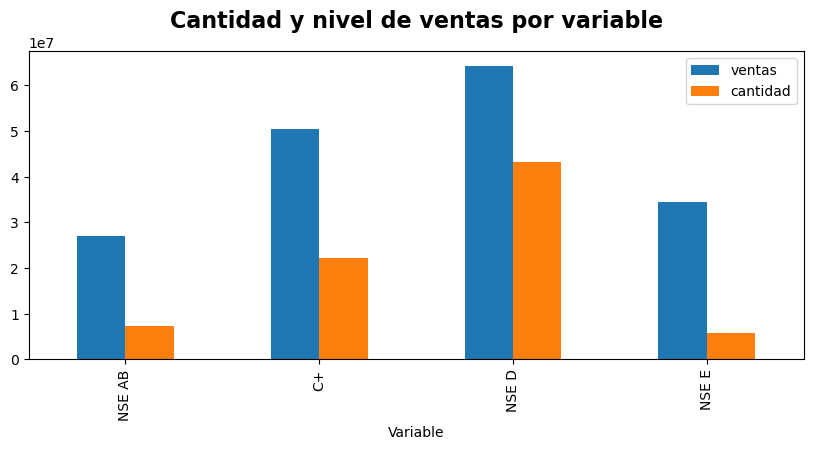

In [25]:
ax1=comparativo.plot(x='Variable',
            kind='bar',
            y=['ventas','cantidad'],
            figsize=(10, 4),
            )
#plt.xticks(rotation=70)
plt.title('Cantidad y nivel de ventas por variable',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()




In [26]:
df3=df.drop(['Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre','CustomerId'],axis=1)
df3.head()
#se eliminan las columnas de meses de ventas (ya que ya se tiene ventas totales) y 
#customer id para poder ejecutar la matriz de correlaciones

,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,0 - 17 hombres,0 -17 mujeres,VinosYLicores,ventas_totales
0,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,603.0,1321.840451,1282.971398,1.0,802.135294
1,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,0.0,1860.592252,1778.887042,0.0,883.352294
2,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,0.0,1378.389948,1292.378710,1.0,445.809998
3,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,0.0,1390.713621,1407.834826,1.0,1104.267092
4,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,0.0,1086.902775,943.756174,0.0,579.884397


In [27]:
from scipy.stats import pearsonr

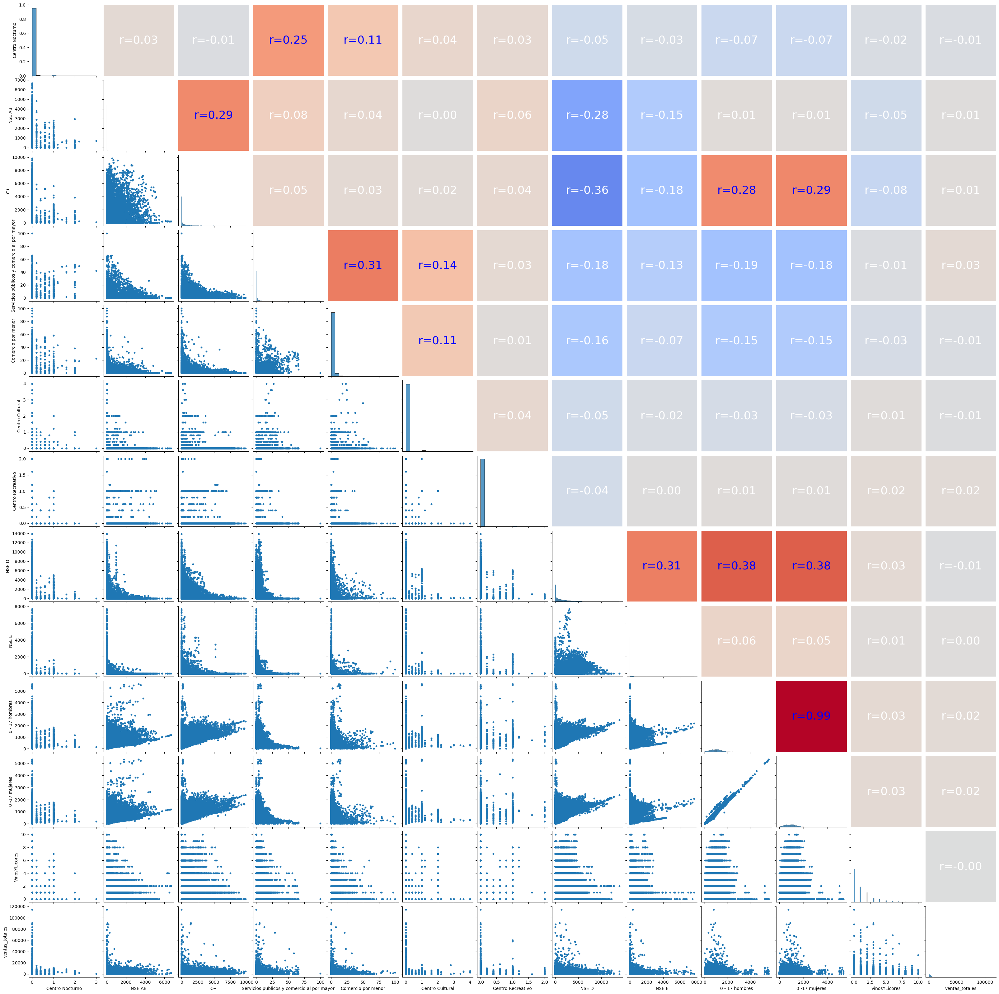

In [28]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(df3) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()
#las correlaciones se comportan igual si estuvieran normalizadas
#Se grafica matriz de correlaciones y distribucion de todo el set de datos. La variables mas correlacionadas de manera positiva
#son las de hombres y mujeres (0.99) y las variables mas correlacionadas de forma negativa son el NSE C+ con el NSE D (-0.36)




In [29]:

EneroP=df['Enero'].mean()
FebreroP=df['Febrero'].mean()
MarzoP=df['Marzo'].mean()
AbrilP=df['Abril'].mean()
MayoP=df['Mayo'].mean()
JunioP=df['Junio'].mean()
JulioP=df['Julio'].mean()
AgostoP=df['Agosto'].mean()
SeptiembreP=df['Septiembre'].mean()
OctubreP=df['Octubre'].mean()
NoviembreP=df['Noviembre'].mean()
DiciembreP=df['Diciembre'].mean()



meses_P=pd.DataFrame({'Mes':['Enero','Febrero','Marzo','Abril','Mayo','Junio','Julio','Agosto','Septiembre',
                               'Octubre','Noviembre','Diciembre'],
            'ventas por mes':[EneroP,FebreroP,MarzoP,AbrilP,MayoP,JunioP,JulioP,AgostoP,
           SeptiembreP,OctubreP,NoviembreP,DiciembreP]})    
 #se sacan las ventas promedio por mes

In [30]:

EneroSum=df['Enero'].sum()
FebreroSum=df['Febrero'].sum()
MarzoSum=df['Marzo'].sum()
AbrilSum=df['Abril'].sum()
MayoSum=df['Mayo'].sum()
JunioSum=df['Junio'].sum()
JulioSum=df['Julio'].sum()
AgostoSum=df['Agosto'].sum()
SeptiembreSum=df['Septiembre'].sum()
OctubreSum=df['Octubre'].sum()
NoviembreSum=df['Noviembre'].sum()
DiciembreSum=df['Diciembre'].sum()

meses_sum=pd.DataFrame({'Mes':['Enero','Febrero','Marzo','Abril','Mayo','Junio','Julio','Agosto','Septiembre',
                               'Octubre','Noviembre','Diciembre'],
            'ventas por mes':[EneroSum,FebreroSum,MarzoSum,AbrilSum,MayoSum,JunioSum,JulioSum,AgostoSum,SeptiembreSum
                              ,OctubreSum,NoviembreSum,DiciembreSum]})

meses_sum

#se obtienes ventas mensuales totales

,Mes,ventas por mes
0,Enero,5.712931e+06
1,Febrero,5.936025e+06
2,Marzo,6.264498e+06
3,Abril,7.090914e+06
4,Mayo,7.271830e+06
5,Junio,7.431339e+06
6,Julio,6.826606e+06
7,Agosto,6.539525e+06
8,Septiembre,6.511261e+06
9,Octubre,6.663209e+06


In [31]:
ventaAnualP=pd.DataFrame(meses_sum.mean())
valortotal=ventaAnualP.loc['ventas por mes', 0]
valortotal
 #se obtiene venta promedio del año

C:\Users\Di.LAPTOP-OGJT2TAD\AppData\Local\Temp\ipykernel_18388\1060357479.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  ventaAnualP=pd.DataFrame(meses_sum.mean())


6579897.507293721

In [32]:
promedioTotal=pd.DataFrame({'Mes':['Enero','Febrero','Marzo','Abril','Mayo','Junio','Julio','Agosto','Septiembre',
                               'Octubre','Noviembre','Diciembre'],
              'ventasTot':[6579897.507293721,6579897.507293721,6579897.507293721,6579897.507293721,6579897.507293721,
                        6579897.507293721,6579897.507293721,6579897.507293721,6579897.507293721,6579897.507293721,
                        6579897.507293721,6579897.507293721]})
promedioTotal.head()
#se crea columna con venta anual promedio para graficar

,Mes,ventasTot
0,Enero,6.579898e+06
1,Febrero,6.579898e+06
2,Marzo,6.579898e+06
3,Abril,6.579898e+06
4,Mayo,6.579898e+06


In [33]:
path2=r'C:\Users\Di.LAPTOP-OGJT2TAD\Documents\materias\maestria analitica de negocios\data mining for decision making\proyecto final\clima.xlsx'

In [34]:
df2 = pd.read_excel(path2,sheet_name='importar') 
df2.head()
#se importa tabla con datos de precipitaciones de lluvias y temperaturas maximas en los estados en los que Arca Continental
#cuenta con presencia

,Mes,Lluvia,Temp Máxima
0,Enero,23.478571,24.014286
1,Febrero,26.414286,25.185714
2,Marzo,19.800000,28.742857
3,Abril,9.821429,31.378571
4,Mayo,24.914286,33.028571


In [35]:
meses=pd.merge(left=meses_sum, right=promedioTotal,on='Mes') 
evolucion=pd.merge(left=meses,right=df2,on='Mes')
evolucion=evolucion.set_index('Mes')
#se unen tablas para graficar

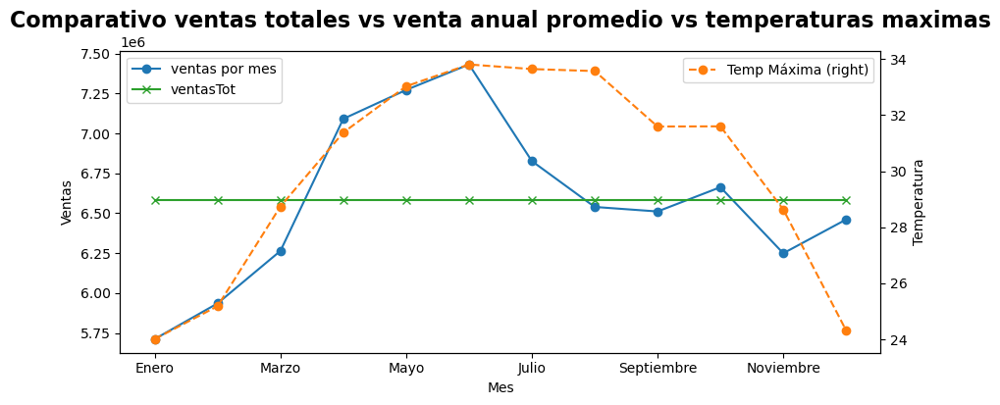

In [36]:
ax1 = evolucion['ventas por mes'].plot(kind="line",marker="o", figsize=(10, 4))

ax2 = evolucion['Temp Máxima'].plot(kind="line", linestyle="dashed",
                         marker="o", secondary_y=True,
                         )
ax3=evolucion['ventasTot'].plot(kind="line",
                         marker="x",
                         )

ax1.set_ylabel("Ventas")
ax2.set_ylabel("Temperatura")
ax1.legend(loc="upper left")
ax2.legend(loc="upper right")
ax1.set_title('Comparativo ventas totales vs venta anual promedio vs temperaturas maximas',
               fontsize=16, weight="bold", y=1.05)
plt.show()
#junio es el mes que mas ventas se tienen, algo interesante es que si bien en marzo comenzaron las cuarentenas no
#se evidencia una caida en ventas

#se tienen 5 meses (abril, mayo, junio, julio y octubre) con ventas por arriba del promedio de ventas totales, mostrando
#una concordancia con los meses con mayores temperaturas en el año.

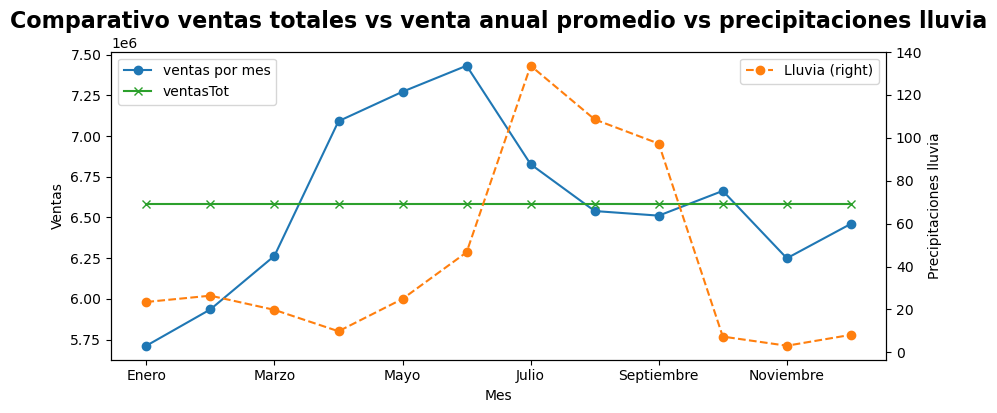

In [37]:
ax1 = evolucion['ventas por mes'].plot(kind="line",marker="o", figsize=(10, 4))

ax2 = evolucion['Lluvia'].plot(kind="line", linestyle="dashed",
                         marker="o", secondary_y=True,
                         )
ax3=evolucion['ventasTot'].plot(kind="line",
                         marker="x",
                         )

ax1.set_ylabel("Ventas")
ax2.set_ylabel("Precipitaciones lluvia")
ax1.legend(loc="upper left")
ax2.legend(loc="upper right")
ax1.set_title('Comparativo ventas totales vs venta anual promedio vs precipitaciones lluvia',
               fontsize=16, weight="bold", y=1.05)
plt.show()
#se evidencia que si bien las temperaturas aun eran altas durante los meses de junio a septiembre, las ventas no muestran
#una correlacion positiva, esto podría haberse visto afectado por la mayor cantidad de lluvias durante esos meses.

In [38]:

top10=df.pivot_table(index = 'CustomerId', 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
top10.sort_values('ventas_totales',ascending=False, inplace=True)
top10.reset_index(inplace=True)
top10.rename({'index':'CustomerId'},
              axis=1,
              inplace=True)
top10=top10.iloc[0:10,0:2]
top10
#top 10 de clientes en base a ventas totales (generan ventas por aprox $822K)

,CustomerId,ventas_totales
0,12364,114353.828983
1,6052,90805.777757
2,6481,88648.627360
3,16671,88302.803400
4,43939,83675.692544
5,12488,78614.615817
6,29178,73256.261144
7,421,69112.776538
8,12391,68185.366378
9,23012,67670.223442


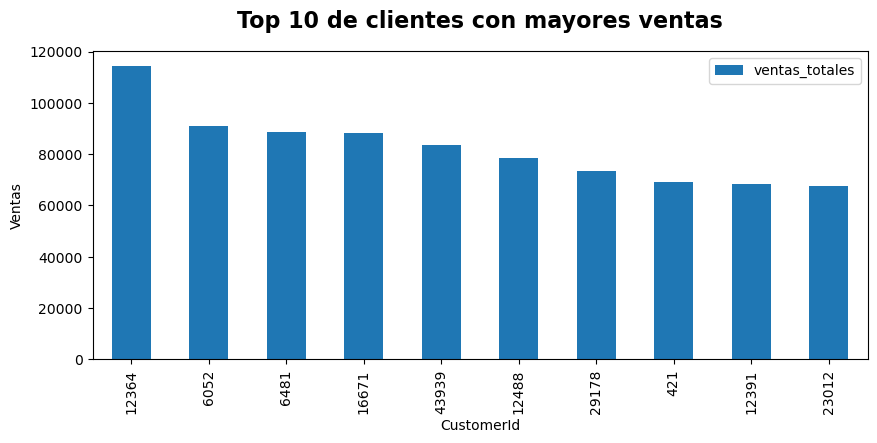

In [39]:
ax1=top10.plot(x='CustomerId',
            kind='bar',
            y=['ventas_totales'],
            figsize=(10, 4)
           )
ax1.set_ylabel("Ventas")
ax1.set_title('Top 10 de clientes con mayores ventas',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

#El cliente nro 12364 es el que tiene mayores ventas durante el año 2020

In [40]:
topNSE=df.pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE.reset_index(inplace=True)
topNSE=topNSE.iloc[0:10,0:6]
#se obtiene tabla de NSE del top 10 clientes

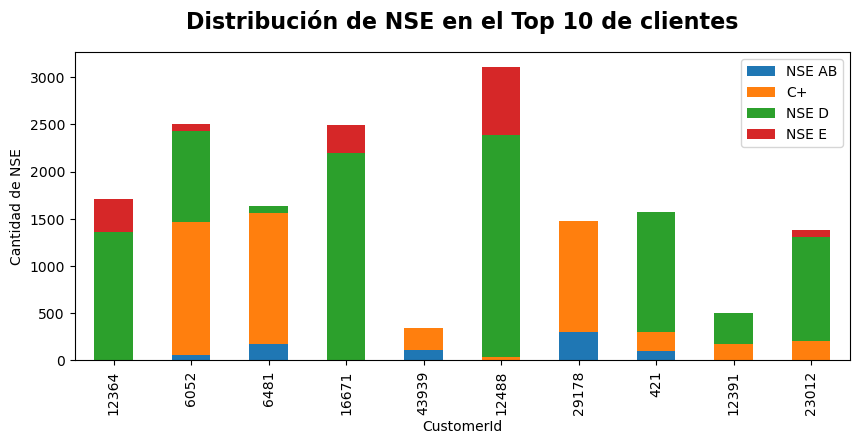

In [41]:
ax1=topNSE.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad de NSE")
ax1.set_title('Distribución de NSE en el Top 10 de clientes',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()
#los niveles medios y bajos son los que consumen más dentro del top 10 de clientes


In [42]:
topG=df.pivot_table(index = ['CustomerId','0 - 17 hombres','0 -17 mujeres'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topG.sort_values('ventas_totales',ascending=False, inplace=True)
topG.reset_index(inplace=True)
topG=topG.iloc[0:10,0:4]
#se obtiene tabla de géneros del top 10 clientes

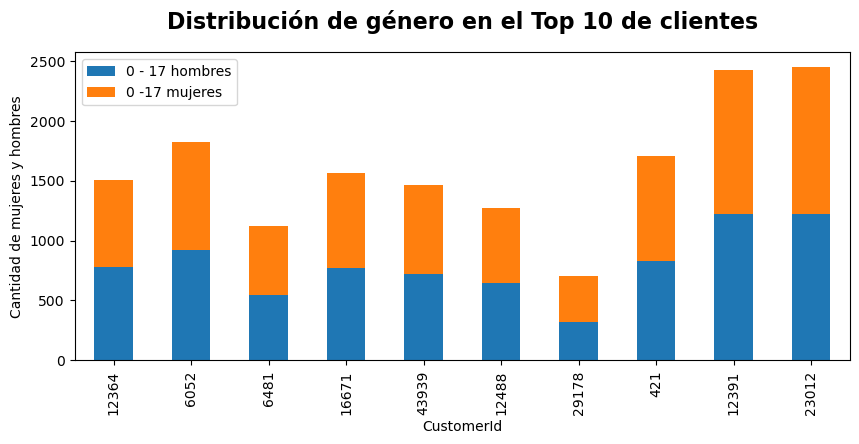

In [43]:
ax1=topG.plot(x='CustomerId',
            kind='bar',
            y=['0 - 17 hombres','0 -17 mujeres'],
           figsize=(10, 4), stacked=True
            )
ax1.set_ylabel("Cantidad de mujeres y hombres")
ax1.set_title('Distribución de género en el Top 10 de clientes',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()
#no muestra una tendencia marcada en preferencia de compra por parte de hombres o mujeres

In [44]:
topCentros=df.pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros.reset_index(inplace=True)
topCentros=topCentros.iloc[0:10,0:5]
topCentros
#la ubicacion con referencia a los centros nocturno, cultural o recreativo no es un factor que influya en el volumen de ventas
#adicionalmente considerar que esta data contempla el primer año de pandemia (2020), por lo cual estos centros nocturnos, culturales
#y recreativos fueron los mayormente afectados por la pandemia

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,12364,0.0,0.0,0.0,114353.828983
1,6052,0.0,0.0,0.0,90805.777757
2,6481,0.0,0.0,0.0,88648.627360
3,16671,0.0,0.0,0.0,88302.803400
4,43939,0.0,0.0,0.0,83675.692544
5,12488,0.0,0.0,0.0,78614.615817
6,29178,0.0,0.0,0.0,73256.261144
7,421,0.0,0.0,0.0,69112.776538
8,12391,0.0,0.0,0.0,68185.366378
9,23012,0.0,0.0,0.0,67670.223442


In [45]:
topOtros=df.pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros.reset_index(inplace=True)
topOtros=topOtros.iloc[0:10,0:5]
#se obtiene tabla de otros comercios del top 10 clientes

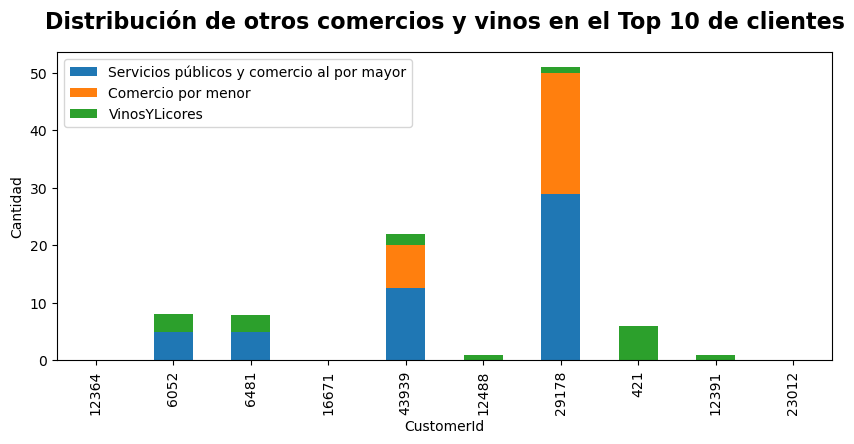

In [46]:
ax1=topOtros.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()
#la cercania con ventas de vinos y licores no es un factor influyente en la venta del top 10 de clientes
#viendo que no existian centros culturales, recreativos, nocturnos ni otros comercios, se podria inferir que las ventas
#generadas por el top 10 de clientes son mayormente en zonas residenciales

In [47]:
df4=df.sort_values('ventas_totales',ascending=False,inplace=True)
df4=df.drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId'],axis=1)

df4=df4.iloc[0:10,:]
df4=df4.T
df4.columns=['12364','6052','6481','16671','43939','12488','29178','421','12391','23012']
#se obtiene tabla de ventas por mes del top 10 clientes

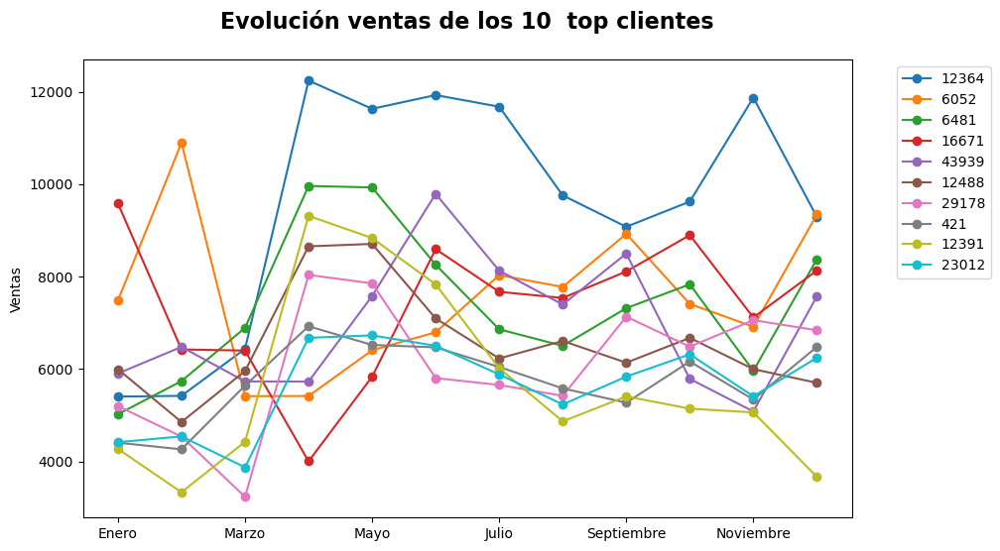

In [48]:
df4['12364'].plot(kind="line",marker="o", figsize=(10, 6),)
df4['6052'].plot(kind="line",marker="o", )
df4['6481'].plot(kind="line",marker="o", )
df4['16671'].plot(kind="line",marker="o", )
df4['43939'].plot(kind="line",marker="o", )
df4['12488'].plot(kind="line",marker="o",)
df4['29178'].plot(kind="line",marker="o", )
df4['421'].plot(kind="line",marker="o", )
df4['12391'].plot(kind="line",marker="o", )
df4['23012'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [49]:
df5=df.sort_values('ventas_totales',ascending=False,inplace=True)
df5=df.drop(['Centro Nocturno', 
       'Centro Cultural', 'Centro Recreativo','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)

df5=df5.iloc[0:10,:]
#se obtiene tabla del top 10 clientes eliminando ciertas columnas, para realizar la matriz de correlaciones

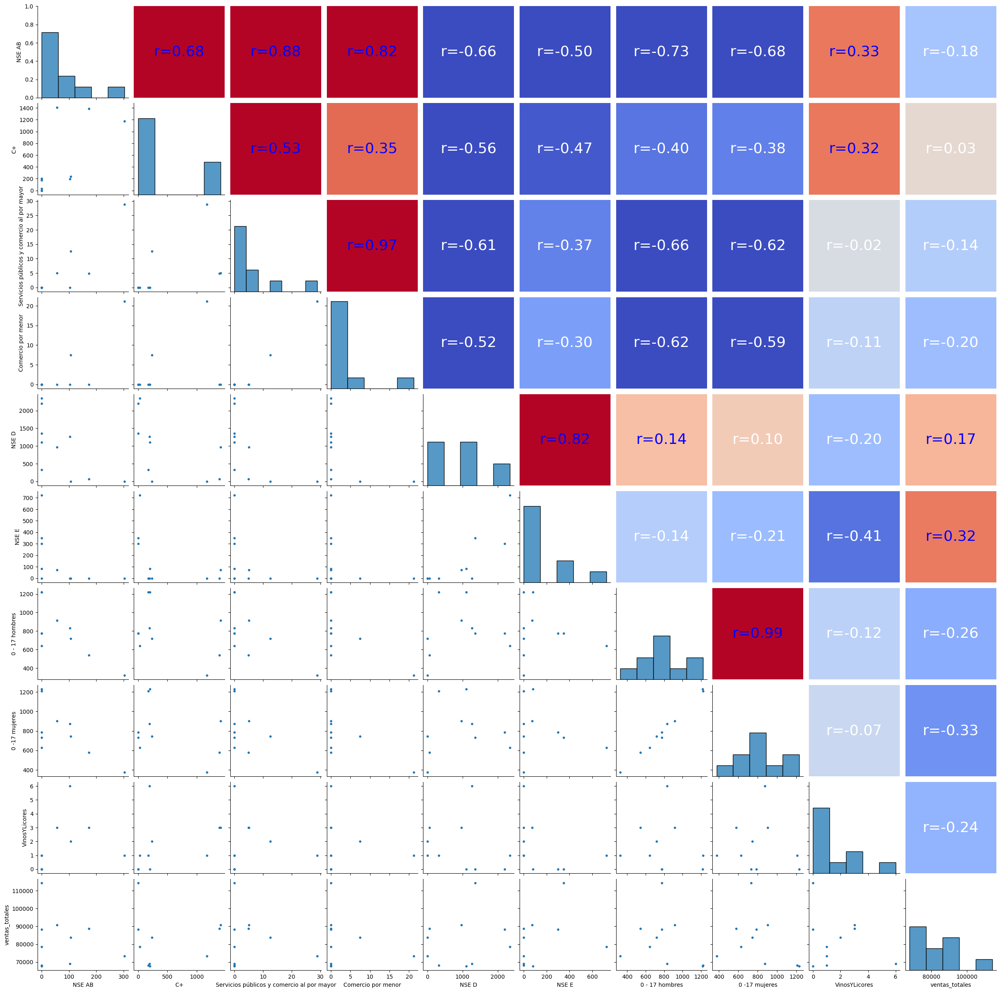

In [50]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(df5) #para crear la matriz de graficos 
g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions

plt.show()

#matriz de correlaciones y distribuciones del top 10 clientes

# PCA

In [51]:
tabla2=df.iloc[:,1:13]
tabla2.head()
#se seleccionan las variables que entraran al analisis (no se consideran las variables explicadas que son ventas, ni 
#customer id)
#ojo conn datos perdidos no funciona PCA
#no deben haber var cualitativas para el PCA

,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,0 - 17 hombres,0 -17 mujeres,VinosYLicores
12363,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,1360.0,350.0,776.840621,730.733964,0.0
6051,0.0,56.0,1410.0,5.000000,0.0,0.0,0.0,965.0,73.0,917.032834,902.822816,3.0
6480,0.0,173.0,1390.0,4.878049,0.0,0.0,0.0,68.0,0.0,542.477409,578.380631,3.0
16670,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,2197.0,300.0,774.455555,786.311574,0.0
43938,0.0,107.0,238.0,12.500000,7.5,0.0,0.0,0.0,0.0,718.691727,742.772700,2.0


In [52]:
from sklearn.decomposition import PCA
from sklearn import preprocessing

In [53]:
pca=PCA()
pca.fit(preprocessing.scale(tabla2)) 
#se aplica algoritmo a tabla 2 que ya fue estandarizada, al hacer el scale parece que hace que todas las medias de las
#var sean 0

PCA()

In [54]:
resumen=pd.DataFrame({'Varianza explicada':pca.explained_variance_,
                       'Desv estandar':np.sqrt(pca.explained_variance_),
                       'Varianza proporcional':pca.explained_variance_ratio_,
                        'Varianza acumulada':np.cumsum(pca.explained_variance_ratio_)
                       })
resumen=resumen.T


In [55]:
last=len(resumen.columns)+1
last
resumen.columns=['PC{}'.format(i)for i in range(1, last)]
resumen
#para tener al menos 91% de varianza explicada, se deberian tomar 9 componentes

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
Varianza explicada,2.486713,1.839510,1.298663,1.031185,0.987727,0.959263,0.854656,0.834054,0.710342,0.636649,0.354907,0.006753
Desv estandar,1.576931,1.356286,1.139589,1.015473,0.993845,0.979420,0.924476,0.913265,0.842818,0.797903,0.595741,0.082177
Varianza proporcional,0.207219,0.153287,0.108218,0.085929,0.082308,0.079936,0.071219,0.069502,0.059193,0.053052,0.029575,0.000563
Varianza acumulada,0.207219,0.360506,0.468724,0.554653,0.636961,0.716897,0.788115,0.857617,0.916811,0.969863,0.999437,1.000000


In [56]:
componentes=pd.DataFrame(pca.components_.transpose(),
                        columns=resumen.columns,
                        index=tabla2.columns)
componentes
#por los pesos de las variables en cada componente: el primer componente podria denominarse como la caracteristica genero,el 2do
#componente podria determinarse como la caracteristica de NSE, el pc3 como centros y comercios y asi sucesivamente.
#todas las variables hasta el componente nro 9 son releventas en alguno de ellos, por lo tanto, todas las variables
#son importantes para explicar la variabilidad de los datos

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12
Centro Nocturno,-0.139039,0.074748,0.472752,-0.098135,0.223093,-0.530904,-0.517510,-0.046387,-0.165288,-0.335763,-0.017339,-0.000401
NSE AB,-0.096166,0.427317,-0.193179,0.059067,0.161338,-0.048653,-0.160510,0.523249,0.652023,-0.114258,-0.034596,-0.003012
C+,0.067005,0.588577,-0.132118,-0.038249,0.002573,0.049125,-0.005322,0.111881,-0.508501,0.125676,-0.583723,0.010182
Servicios públicos y comercio al por mayor,-0.289714,0.177707,0.489823,-0.067069,-0.054531,-0.118931,0.114512,0.002649,0.159197,0.762591,0.054180,0.000180
Comercio por menor,-0.242956,0.129517,0.425618,-0.141503,-0.104950,0.108192,0.652918,0.174920,-0.015649,-0.491461,-0.040295,0.001417
Centro Cultural,-0.086936,0.074221,0.365289,0.211438,-0.166954,0.750460,-0.455010,-0.030455,0.019983,-0.096352,-0.009089,0.000342
Centro Recreativo,-0.017516,0.091325,0.080084,0.669018,0.648889,0.035770,0.231268,-0.247664,-0.002423,-0.000944,-0.013705,-0.000940
NSE D,0.392540,-0.359718,0.268612,-0.069266,0.058906,-0.013807,0.033601,-0.041833,0.372640,0.023606,-0.702518,0.008710
NSE E,0.166484,-0.346373,0.138367,-0.005899,0.324980,0.115762,-0.009137,0.744731,-0.344281,0.157519,0.126683,-0.004122
0 - 17 hombres,0.562536,0.269767,0.180798,-0.020429,-0.047518,-0.024171,0.050099,-0.036248,0.029394,-0.007303,0.272458,0.704172


# CLUSTERING

In [57]:
df.nunique()
#las variables como ventas, customer id ,0 - 17 hombres  y 0 -17 mujeres no serán consideradas en el análisis por 
#el nivel de datos únicos que contienen

CustomerId                                    28460
Centro Nocturno                                  12
NSE AB                                         2797
C+                                             5311
Servicios públicos y comercio al por mayor     2710
Comercio por menor                             1498
Centro Cultural                                  15
Centro Recreativo                                 9
NSE D                                          7276
NSE E                                          2372
0 - 17 hombres                                26149
0 -17 mujeres                                 26145
VinosYLicores                                    11
Enero                                         22759
Febrero                                       22721
Marzo                                         22750
Abril                                         22377
Mayo                                          22545
Junio                                         22829
Julio       

In [58]:
df6=df.drop(['CustomerId', '0 - 17 hombres', '0 -17 mujeres','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre', 'ventas_totales'],axis=1)
df6.head()

,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,VinosYLicores
12363,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,1360.0,350.0,0.0
6051,0.0,56.0,1410.0,5.000000,0.0,0.0,0.0,965.0,73.0,3.0
6480,0.0,173.0,1390.0,4.878049,0.0,0.0,0.0,68.0,0.0,3.0
16670,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,2197.0,300.0,0.0
43938,0.0,107.0,238.0,12.500000,7.5,0.0,0.0,0.0,0.0,2.0


In [59]:
df6norm = df6.apply(preprocessing.scale, axis=0)
df6norm.head()
#se estandarizan los datos

,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,VinosYLicores
12363,-0.11016,-0.372110,-0.602292,-0.573541,-0.312256,-0.123749,-0.119166,-0.092429,0.328180,-0.720797
6051,-0.11016,-0.290272,0.481306,0.365358,-0.312256,-0.123749,-0.119166,-0.323483,-0.276225,1.096198
6480,-0.11016,-0.119288,0.465936,0.342458,-0.312256,-0.123749,-0.119166,-0.848183,-0.435508,1.096198
16670,-0.11016,-0.372110,-0.602292,-0.573541,-0.312256,-0.123749,-0.119166,0.397174,0.219082,-0.720797
43938,-0.11016,-0.215741,-0.419386,1.773707,1.238274,-0.123749,-0.119166,-0.887959,-0.435508,0.490533


In [60]:
from sklearn.cluster import KMeans

In [61]:
wcss=[] 
max_centroid=30

for i in range (1, max_centroid):
    km=KMeans(n_clusters=i,
             random_state=0,
             init='k-means++' 
             )
    km.fit(df6norm)
    wcss.append(km.inertia_) 
    #print('For cluster nro {} ,\t inertia is {}'.format(i,km.inertia_)) 

#se aplica el algoritmo con una iteracion de 30 clusters para conocer si el "codo" se encuentra dentro de este rango

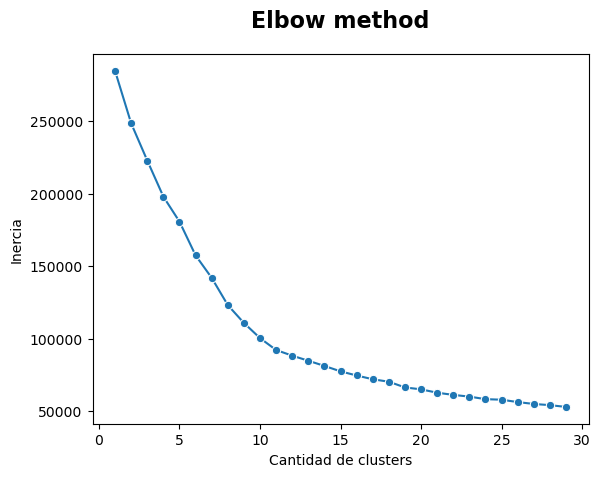

In [62]:
sns.lineplot(x=range(1,30),
            y=wcss,
            marker='o',
            )
plt.ylabel("Inercia")
plt.xlabel("Cantidad de clusters")
plt.title('Elbow method',
               fontsize=16, weight="bold", y=1.05)
plt.show()
#viendo el punto de inflexión, el nivel óptimo de clusters serían 10

In [63]:
km= KMeans(n_clusters=10, 
          random_state=0  
          )
km.fit(df6norm)
#se aplica el algoritmo con 10 clusters

KMeans(n_clusters=10, random_state=0)

In [64]:
print('centroids are',km.cluster_centers_)
print('inertia is', km.inertia_)
#se obtienen los centroides (10 centroides con 10 ejes por las variables) y el dato de la inercia

centroids are [[-1.01155420e-01  4.02102087e-01  2.24244384e+00  8.64999674e-02
   2.72131355e-02 -1.16885174e-01 -1.05379192e-01 -7.49870151e-01
  -4.05638238e-01 -2.87680545e-01]
 [-1.04452172e-01 -2.64604062e-01 -2.69570480e-01 -1.10237395e-01
  -1.26441641e-01 -1.18740956e-01 -1.14265015e-01 -3.33483963e-01
  -2.29417915e-01 -3.65384768e-01]
 [ 2.52366996e-01  3.75949286e-01  3.30088437e-01  2.16838423e-01
   2.63967478e-02 -1.40875020e-02  8.43998909e+00 -3.23935376e-01
   2.43261029e-02  2.51989277e-01]
 [-1.08307249e-01 -3.49104173e-01 -4.89719806e-01 -2.60783887e-01
  -2.50175429e-01 -1.17245798e-01 -1.18830660e-01  1.61553631e+00
   4.13660279e-01 -2.35953649e-01]
 [ 1.57750544e-01  3.67879972e-02 -2.80670732e-01  3.27902592e+00
   4.61159931e+00  3.68999215e-02 -9.68166389e-02 -6.89588148e-01
  -2.49960746e-01 -2.37861157e-01]
 [-7.11866091e-02  3.71506125e+00  4.42695386e-01  1.21006630e-01
   5.60519341e-02 -1.10358112e-01 -7.81812640e-02 -8.27040791e-01
  -4.15795243e-01 -

In [65]:
clusters=km.labels_.tolist()
df.insert(0,'clusters',clusters)
df.head()
#se asigna a cada fila/cliente su cluster respectivo

,clusters,CustomerId,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,...,Abril,Mayo,Junio,Julio,Agosto,Septiembre,Octubre,Noviembre,Diciembre,ventas_totales
12363,1,12364,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,1360.0,...,12241.320012,11629.788256,11926.966525,11675.3730,9756.7288,9077.1857,9622.6258,11871.3585,9290.8618,114353.828983
6051,7,6052,0.0,56.0,1410.0,5.000000,0.0,0.0,0.0,965.0,...,5416.770178,6405.958083,6795.105414,8030.8118,7775.7080,8925.3007,7408.0694,6914.8575,9343.4977,90805.777757
6480,7,6481,0.0,173.0,1390.0,4.878049,0.0,0.0,0.0,68.0,...,9961.258534,9929.071713,8256.069547,6859.9473,6501.8247,7317.2553,7833.0912,5961.3661,8376.8841,88648.627360
16670,1,16671,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,2197.0,...,4004.128552,5833.248653,8593.608940,7670.5704,7537.9838,8111.1813,8897.5256,7115.4413,8132.9542,88302.803400
43938,1,43939,0.0,107.0,238.0,12.500000,7.5,0.0,0.0,0.0,...,5728.802976,7579.054345,9789.382633,8128.5388,7394.6996,8497.7885,5786.7647,5082.2160,7573.0720,83675.692544


ANÁLISIS CLUSTER 1

In [66]:
cluster1 = df[df.clusters==1]
cluster1=cluster1.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster1.shape

(13149, 13)

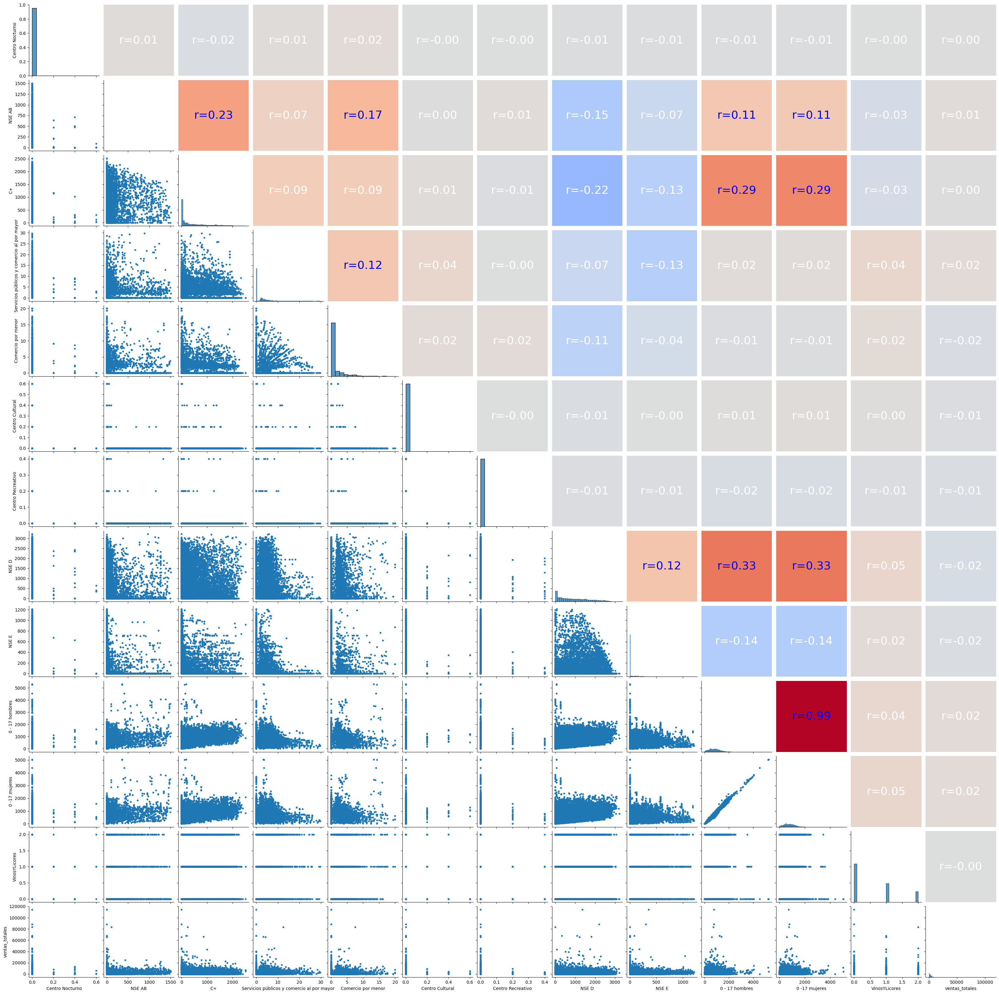

In [67]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster1) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()
#correlaciones de cluster 1

In [68]:
cantidad=cluster1.sum()
CS=cantidad['Servicios públicos y comercio al por mayor']
CCM=cantidad['Comercio por menor']
CV=cantidad['VinosYLicores']

CantxVar=pd.DataFrame({'Variable':['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
                      'cantidad':[CS,CCM,CV]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,Servicios públicos y comercio al por mayor,32442.138982
1,Comercio por menor,11818.242978
2,VinosYLicores,7716.000000


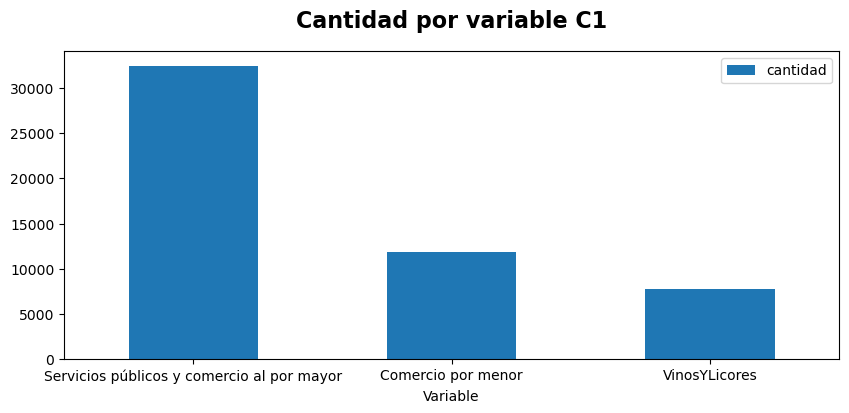

In [69]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C1',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [70]:
cantidad=cluster1.sum()
CCN=cantidad['Centro Nocturno']
CCC=cantidad['Centro Cultural']
CCR=cantidad['Centro Recreativo']
CantxVar=pd.DataFrame({'Variable':['Centro Nocturno','Centro Cultural','Centro Recreativo',],
                      'cantidad':[CCN,CCC,CCR]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,Centro Nocturno,9.6
1,Centro Cultural,10.4
2,Centro Recreativo,7.6


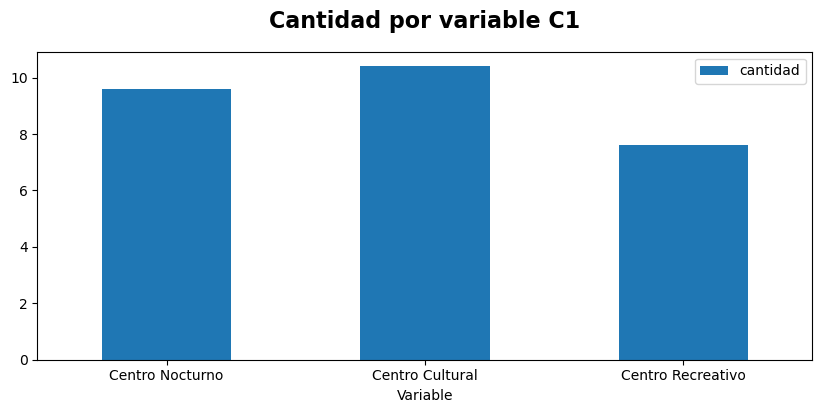

In [71]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C1',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [72]:
topNSE1=df[df.clusters==1].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE1.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE1.reset_index(inplace=True)
topNSE1=topNSE1.iloc[0:10,0:6]
#tabla de top 10 de cluster 1 en base a NSE

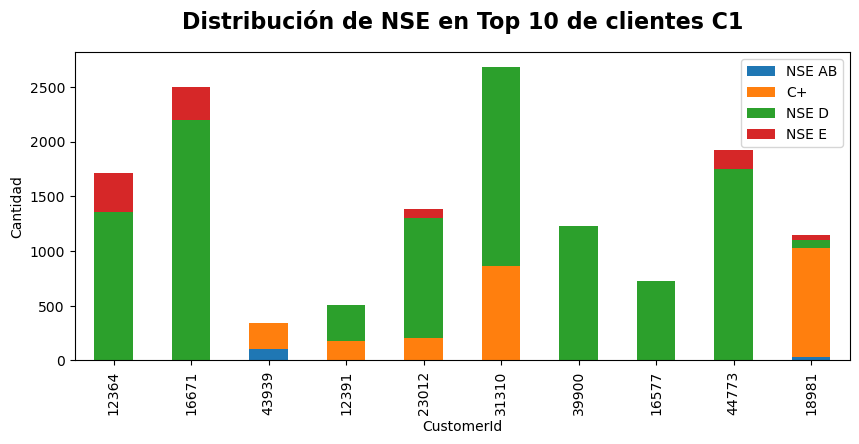

In [73]:
ax1=topNSE1.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C1',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [74]:
topCentros1=df[df.clusters==1].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros1.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros1.reset_index(inplace=True)
topCentros1=topCentros1.iloc[0:10,0:5]
topCentros1
#top 10 de cluster 1 en base a centros.la ubicacion con referencia a los centros nocturno, cultural o recreativo no es un factor 
#que influya en el volumen de ventas de dicho cluster

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,12364,0.0,0.0,0.0,114353.828983
1,16671,0.0,0.0,0.0,88302.803400
2,43939,0.0,0.0,0.0,83675.692544
3,12391,0.0,0.0,0.0,68185.366378
4,23012,0.0,0.0,0.0,67670.223442
5,31310,0.0,0.0,0.0,66486.942130
6,39900,0.0,0.0,0.0,65894.291066
7,16577,0.0,0.0,0.0,46059.755290
8,44773,0.0,0.0,0.0,44074.947278
9,18981,0.0,0.0,0.0,43511.426039


In [75]:
topOtros1=df[df.clusters==1].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros1.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros1.reset_index(inplace=True)
topOtros1=topOtros1.iloc[0:10,0:5]
#tabla de top 10 de cluster 1 en base a otros comercios y vinos

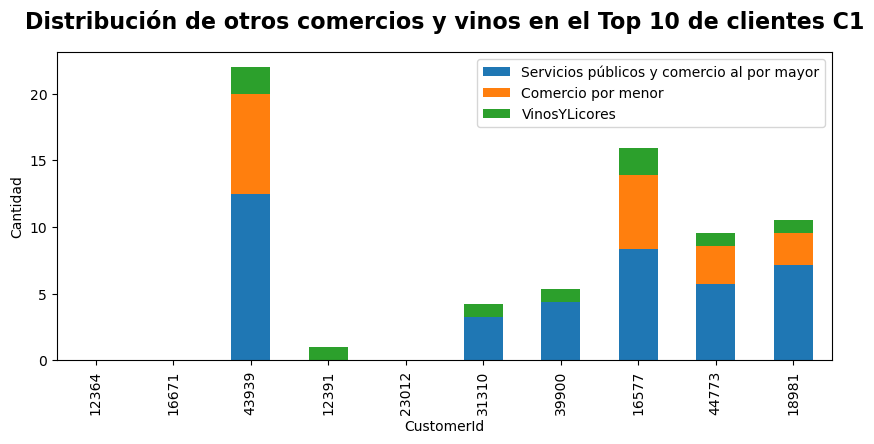

In [76]:
ax1=topOtros1.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C1',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [77]:
df41=df.sort_values('ventas_totales',ascending=False,inplace=True)
df41=df[df.clusters==1].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df41=df41.iloc[0:10,:]
df41=df41.T
df41.columns=['12364','16671','43939','12391','23012','31310','39900','16577','44773','18981']
#se obtiene tabla de evolucion de ventas por mes por top 10 clientes del cluster 1

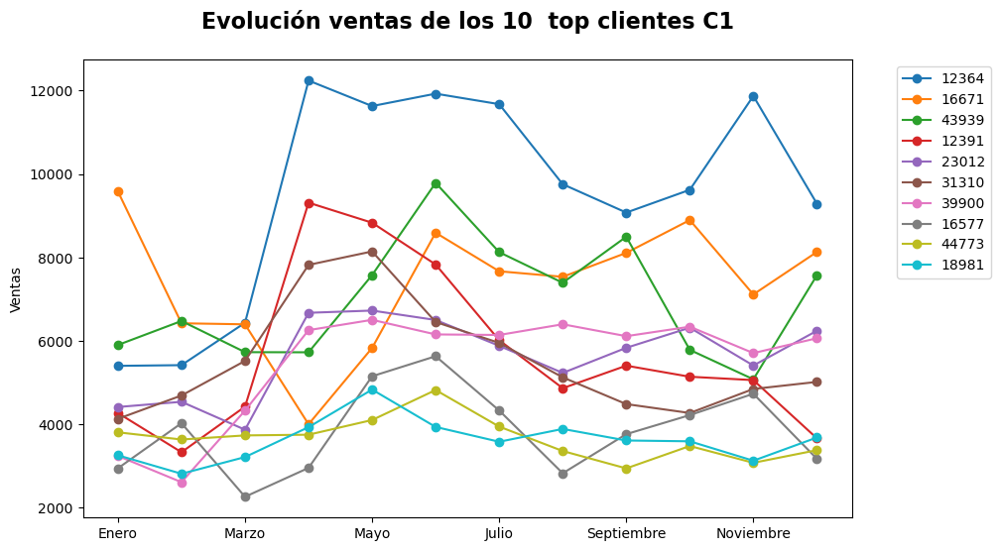

In [78]:
df41['12364'].plot(kind="line",marker="o", figsize=(10, 6),)
df41['16671'].plot(kind="line",marker="o", )
df41['43939'].plot(kind="line",marker="o", )
df41['12391'].plot(kind="line",marker="o", )
df41['23012'].plot(kind="line",marker="o", )
df41['31310'].plot(kind="line",marker="o",)
df41['39900'].plot(kind="line",marker="o", )
df41['16577'].plot(kind="line",marker="o", )
df41['44773'].plot(kind="line",marker="o", )
df41['18981'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C1',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANÁLISIS CLUSTER 2

In [79]:
cluster2 = df[df.clusters==2]
cluster2=cluster2.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster2.shape

(358, 13)

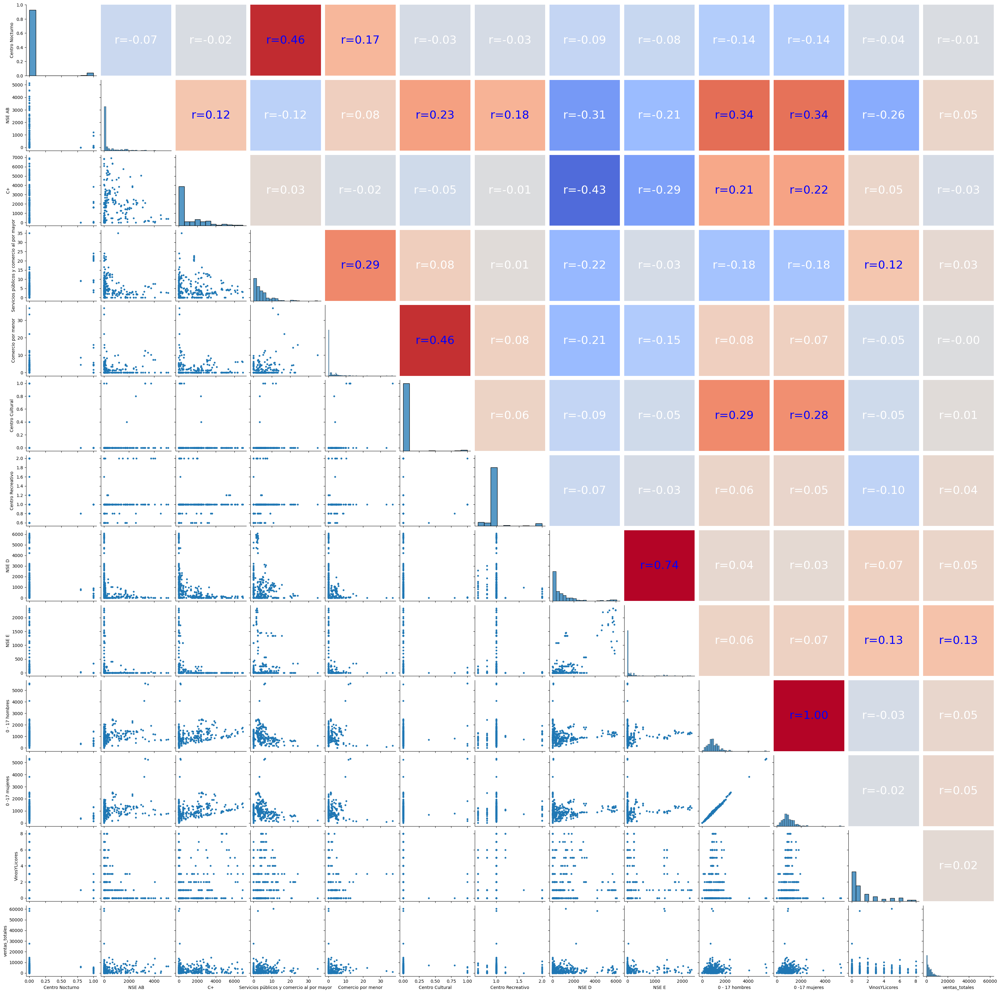

In [80]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster2) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [81]:
cantidad=cluster2.sum()
CCN=cantidad['Centro Nocturno']
CCC=cantidad['Centro Cultural']
CCR=cantidad['Centro Recreativo']
CantxVar=pd.DataFrame({'Variable':['Centro Nocturno','Centro Cultural','Centro Recreativo',],
                      'cantidad':[CCN,CCC,CCR]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,Centro Nocturno,16.6
1,Centro Cultural,6.2
2,Centro Recreativo,361.4


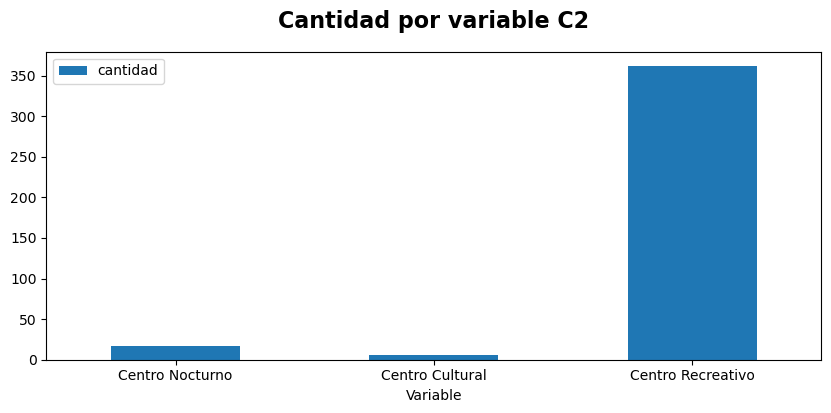

In [82]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C2',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [83]:
topNSE2=df[df.clusters==2].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE2.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE2.reset_index(inplace=True)
topNSE2=topNSE2.iloc[0:10,0:6]


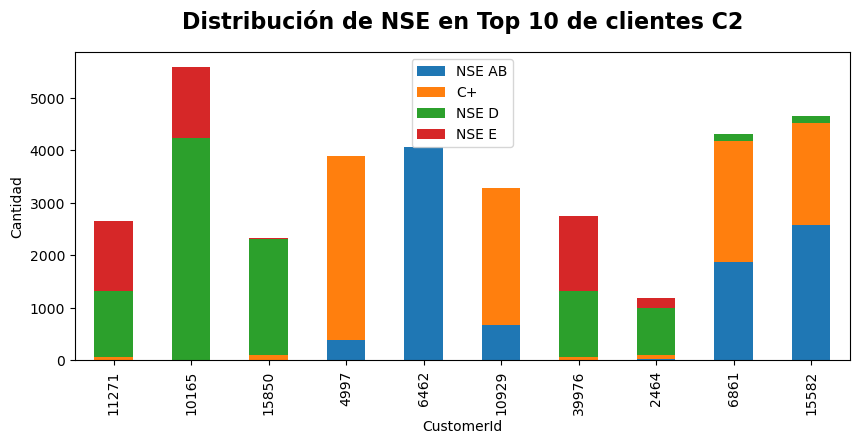

In [84]:
ax1=topNSE2.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C2',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [85]:
topCentros2=df[df.clusters==2].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros2.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros2.reset_index(inplace=True)
topCentros2=topCentros2.iloc[0:10,0:5]
topCentros2

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,11271,0.0,0.0,1.0,60360.743883
1,10165,0.0,0.0,1.0,58192.591754
2,15850,0.0,0.0,1.0,27601.484258
3,4997,0.0,0.0,1.0,14494.873517
4,6462,0.0,0.0,1.0,13613.396843
5,10929,0.0,0.0,1.0,12692.074491
6,39976,0.0,0.0,1.0,12600.800440
7,2464,0.0,0.0,1.0,12093.947653
8,6861,0.0,0.0,1.0,11456.868532
9,15582,0.0,0.0,2.0,11093.929068


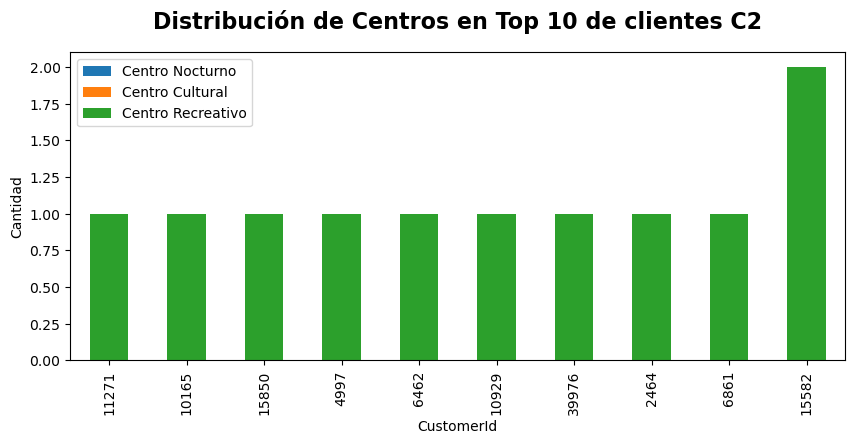

In [86]:
ax1=topCentros2.plot(x='CustomerId',
            kind='bar',
            y=['Centro Nocturno','Centro Cultural','Centro Recreativo'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de Centros en Top 10 de clientes C2',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [87]:
topOtros2=df[df.clusters==2].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros2.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros2.reset_index(inplace=True)
topOtros2=topOtros2.iloc[0:10,0:5]

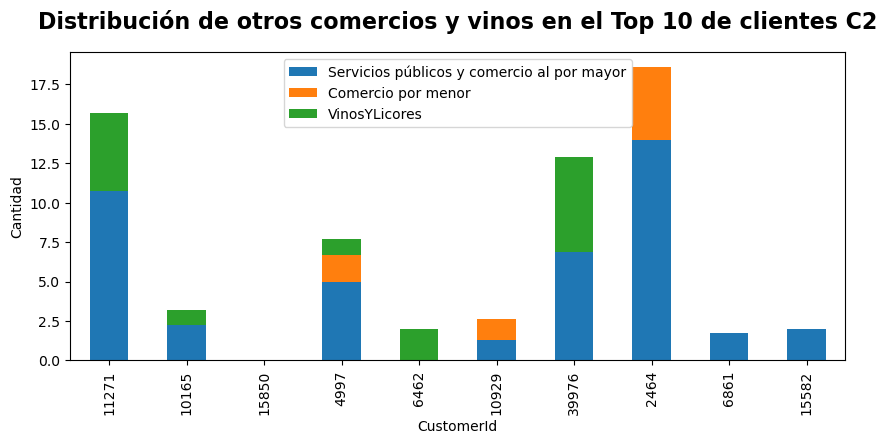

In [88]:
ax1=topOtros2.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C2',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [89]:
df42=df.sort_values('ventas_totales',ascending=False,inplace=True)
df42=df[df.clusters==2].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df42=df42.iloc[0:10,:]
df42=df42.T
df42.columns=['11271','10165','15850','4997','6462','10929','39976','2464','6861','15582']

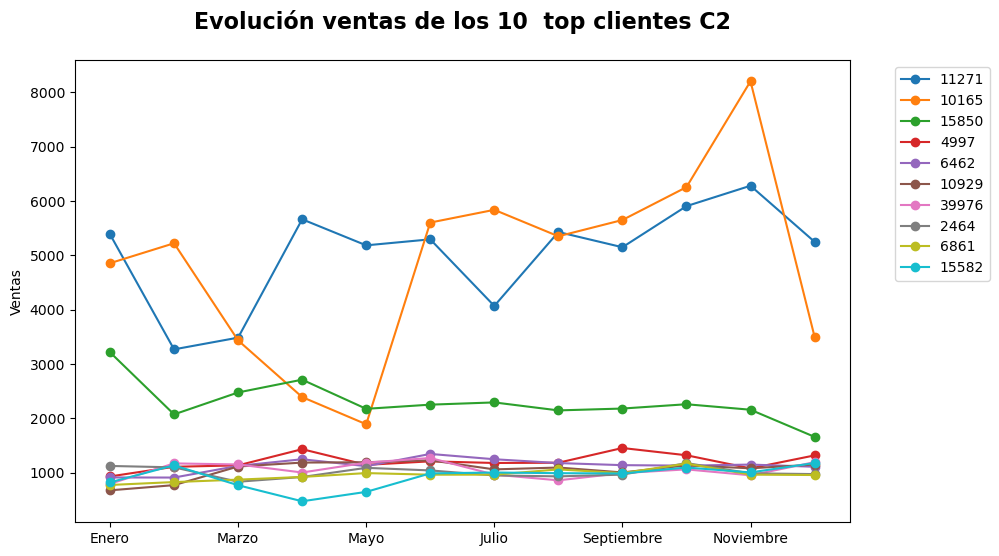

In [90]:
df42['11271'].plot(kind="line",marker="o", figsize=(10, 6),)
df42['10165'].plot(kind="line",marker="o", )
df42['15850'].plot(kind="line",marker="o", )
df42['4997'].plot(kind="line",marker="o", )
df42['6462'].plot(kind="line",marker="o", )
df42['10929'].plot(kind="line",marker="o",)
df42['39976'].plot(kind="line",marker="o", )
df42['2464'].plot(kind="line",marker="o", )
df42['6861'].plot(kind="line",marker="o", )
df42['15582'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C2',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()


ANÁLISIS CLUSTER 3

In [91]:
cluster3 = df[df.clusters==3]
cluster3=cluster3.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster3.shape

(5063, 13)

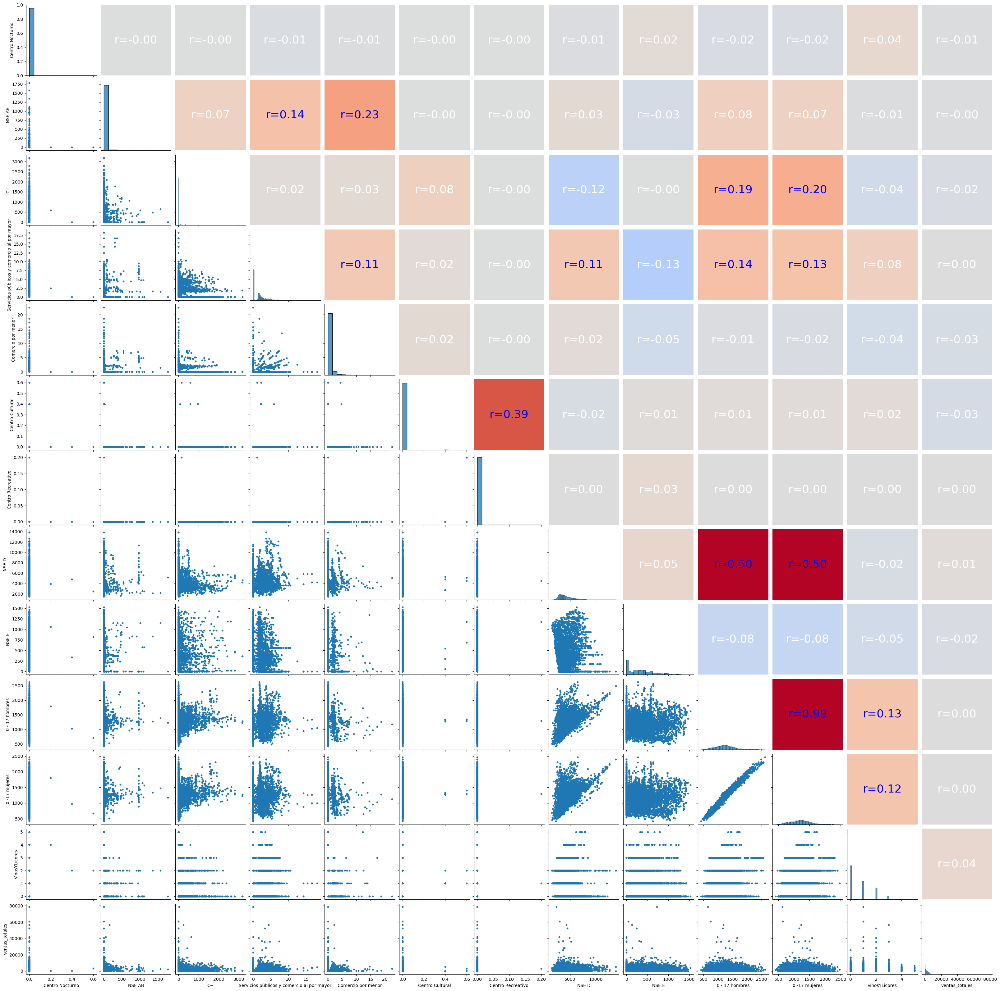

In [92]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster3) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [93]:
cantidad=cluster3.sum()
CAB=cantidad['NSE AB']
CC=cantidad['C+']
CD=cantidad['NSE D']
CE=cantidad['NSE E']
CantxVar=pd.DataFrame({'Variable':['NSE AB','C+','NSE D', 'NSE E'],
                      'cantidad':[CAB,CC,CD,CE]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,NSE AB,79704.4
1,C+,741632.4
2,NSE D,21668895.6
3,NSE E,1970396.0


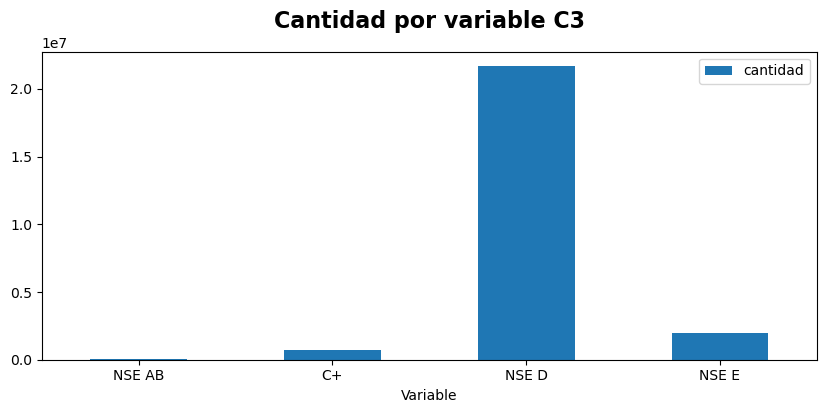

In [94]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C3',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [95]:
topNSE3=df[df.clusters==3].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE3.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE3.reset_index(inplace=True)
topNSE3=topNSE3.iloc[0:10,0:6]

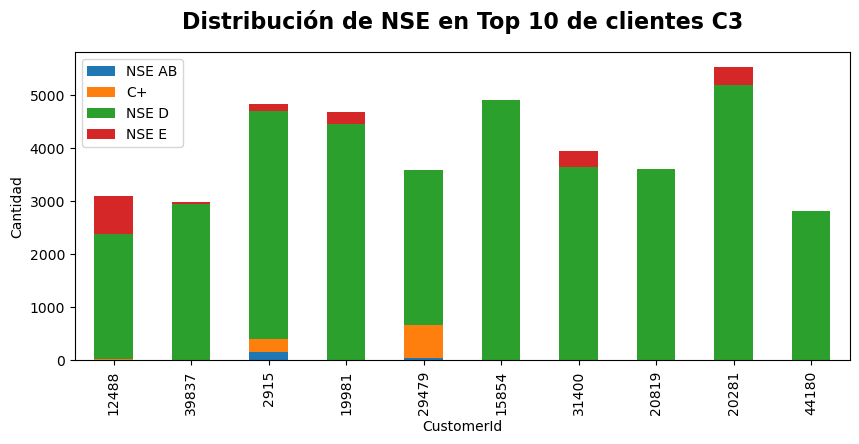

In [96]:
ax1=topNSE3.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C3',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [97]:
topCentros3=df[df.clusters==3].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros3.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros3.reset_index(inplace=True)
topCentros3=topCentros3.iloc[0:10,0:5]
topCentros3

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,12488,0.0,0.0,0.0,78614.615817
1,39837,0.0,0.0,0.0,60702.489208
2,2915,0.0,0.0,0.0,56734.645900
3,19981,0.0,0.0,0.0,52350.305933
4,29479,0.0,0.0,0.0,41853.899384
5,15854,0.0,0.0,0.0,40531.635070
6,31400,0.0,0.0,0.0,36926.022652
7,20819,0.0,0.0,0.0,36287.186291
8,20281,0.0,0.0,0.0,36245.236026
9,44180,0.0,0.0,0.0,35517.025165


In [98]:
topOtros3=df[df.clusters==3].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros3.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros3.reset_index(inplace=True)
topOtros3=topOtros3.iloc[0:10,0:5]


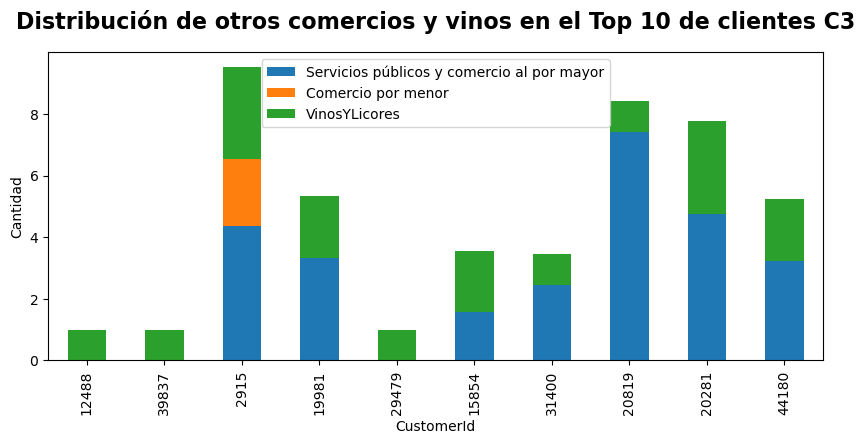

In [99]:
ax1=topOtros3.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C3',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [100]:
df43=df.sort_values('ventas_totales',ascending=False,inplace=True)
df43=df[df.clusters==3].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df43=df43.iloc[0:10,:]
df43=df43.T
df43.columns=['12488','39837','2915','19981','29479','15854','31400','20819','20281','44180']

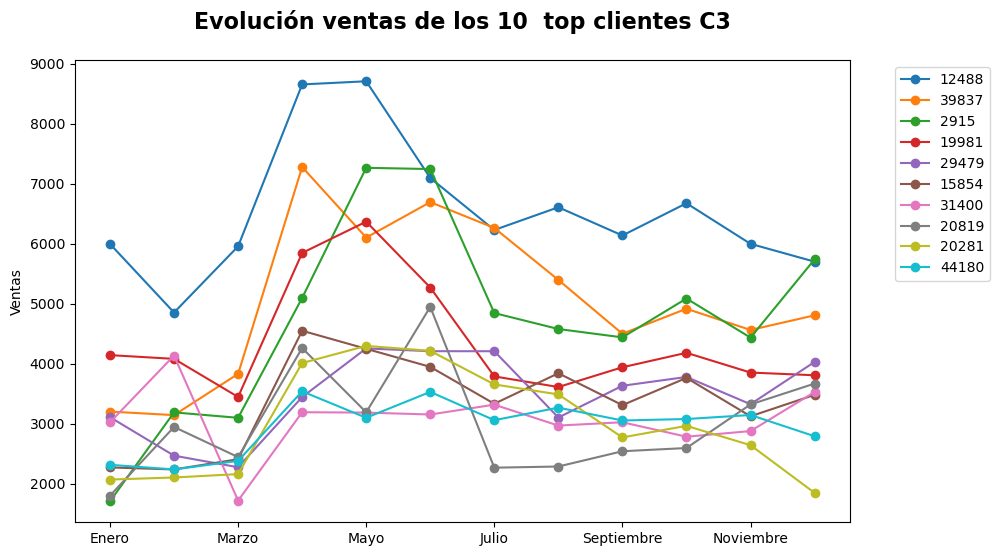

In [101]:
df43['12488'].plot(kind="line",marker="o", figsize=(10, 6),)
df43['39837'].plot(kind="line",marker="o", )
df43['2915'].plot(kind="line",marker="o", )
df43['19981'].plot(kind="line",marker="o", )
df43['29479'].plot(kind="line",marker="o", )
df43['15854'].plot(kind="line",marker="o",)
df43['31400'].plot(kind="line",marker="o", )
df43['20819'].plot(kind="line",marker="o", )
df43['20281'].plot(kind="line",marker="o", )
df43['44180'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C3',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANÁLISIS CLUSTER 4

In [102]:
cluster4 = df[df.clusters==4]
cluster4=cluster4.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster4.shape

(607, 13)

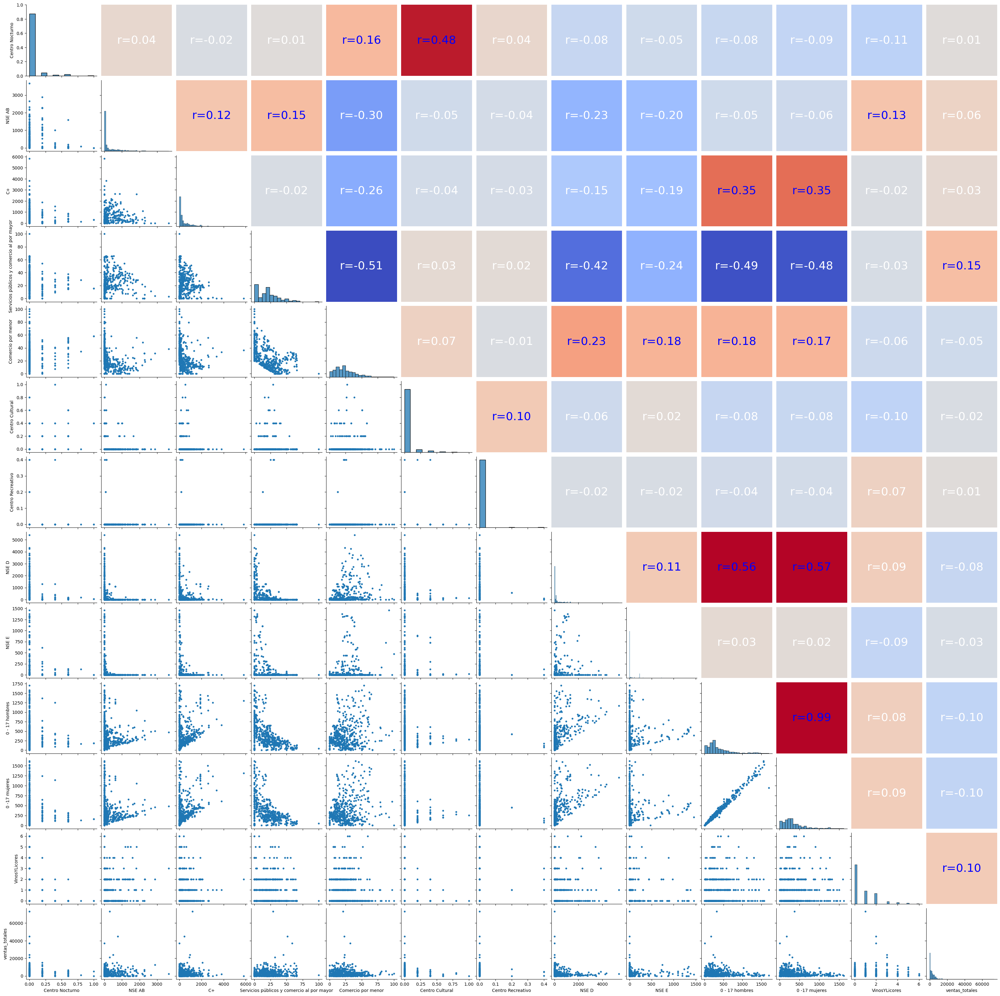

In [103]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster4) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [104]:
cantidad=cluster4.sum()
CS=cantidad['Servicios públicos y comercio al por mayor']
CCM=cantidad['Comercio por menor']
CantxVar=pd.DataFrame({'Variable':['Servicios públicos y comercio al por mayor','Comercio por menor'],
                      'cantidad':[CS,CCM]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,Servicios públicos y comercio al por mayor,12453.456740
1,Comercio por menor,14456.900419


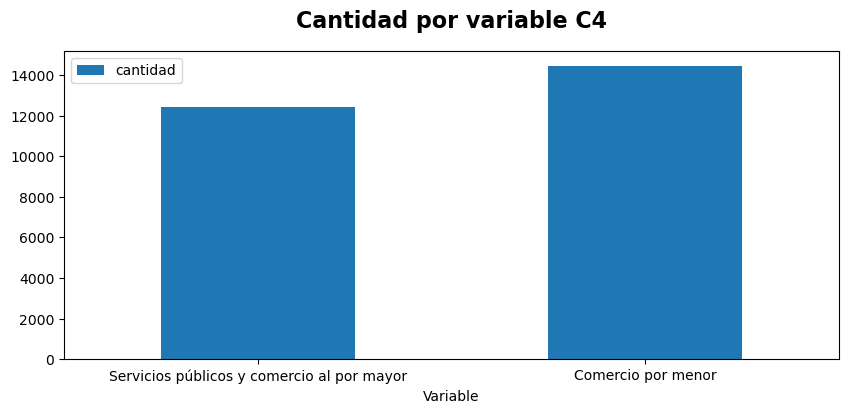

In [105]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C4',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [106]:
topNSE4=df[df.clusters==4].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE4.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE4.reset_index(inplace=True)
topNSE4=topNSE4.iloc[0:10,0:6]

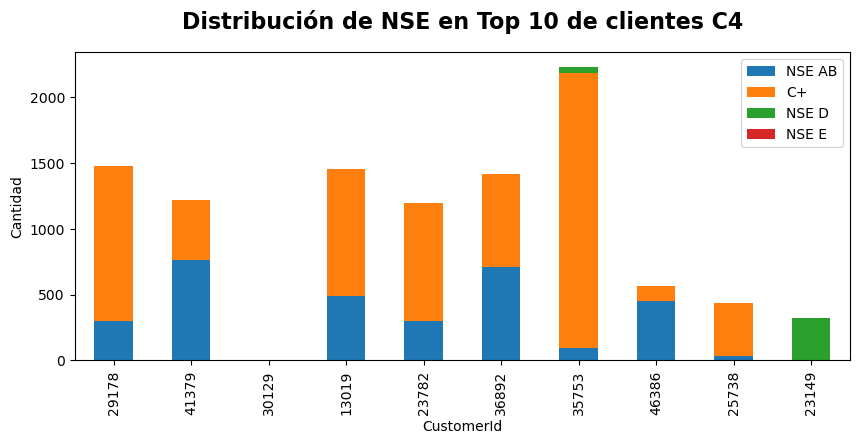

In [107]:
ax1=topNSE4.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C4',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [108]:
topCentros4=df[df.clusters==4].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros4.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros4.reset_index(inplace=True)
topCentros4=topCentros4.iloc[0:10,0:5]
topCentros4

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,29178,0.0,0.0,0.0,73256.261144
1,41379,0.0,0.0,0.0,44972.598256
2,30129,0.0,0.0,0.0,37231.960375
3,13019,0.0,0.0,0.0,24105.383092
4,23782,0.0,0.0,0.0,21271.235103
5,36892,0.2,0.0,0.0,15073.261025
6,35753,0.0,0.0,0.0,15046.383553
7,46386,0.0,0.0,0.0,14432.375259
8,25738,0.0,0.0,0.0,14044.826692
9,23149,0.0,0.0,0.0,13904.387308


In [109]:
topOtros4=df[df.clusters==4].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros4.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros4.reset_index(inplace=True)
topOtros4=topOtros4.iloc[0:10,0:5]

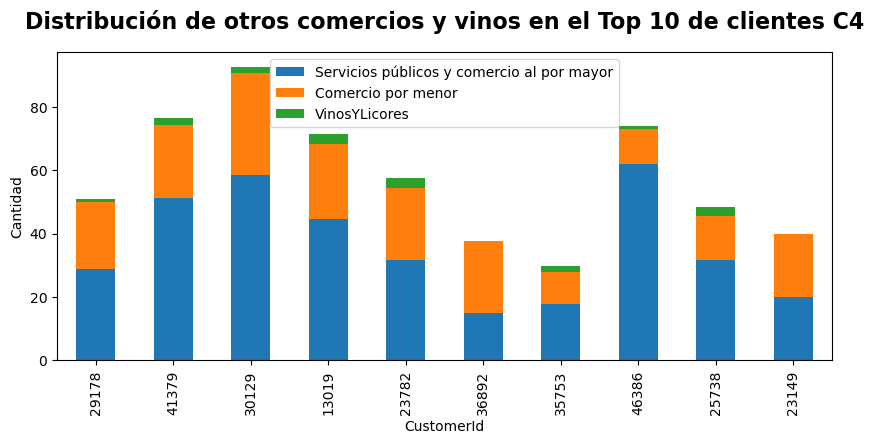

In [110]:
ax1=topOtros4.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C4',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [111]:
df44=df.sort_values('ventas_totales',ascending=False,inplace=True)
df44=df[df.clusters==4].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df44=df44.iloc[0:10,:]
df44=df44.T
df44.columns=['29178','41379','30129','13019','23782','36892','35753','46386','25738','23149']

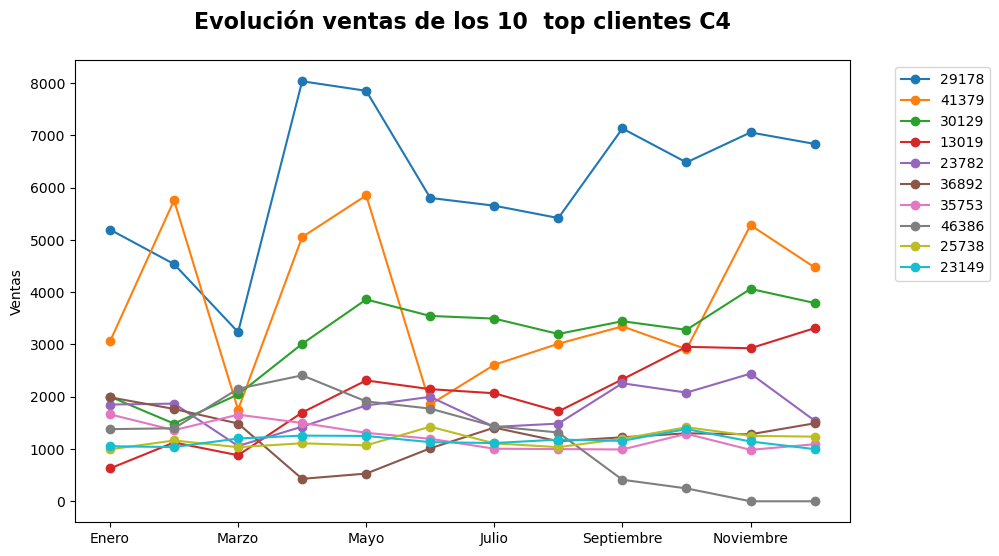

In [112]:
df44['29178'].plot(kind="line",marker="o", figsize=(10, 6),)
df44['41379'].plot(kind="line",marker="o", )
df44['30129'].plot(kind="line",marker="o", )
df44['13019'].plot(kind="line",marker="o", )
df44['23782'].plot(kind="line",marker="o", )
df44['36892'].plot(kind="line",marker="o",)
df44['35753'].plot(kind="line",marker="o", )
df44['46386'].plot(kind="line",marker="o", )
df44['25738'].plot(kind="line",marker="o", )
df44['23149'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C4',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANÁLISIS CLUSTER 5

In [113]:
cluster5 = df[df.clusters==5]
cluster5=cluster5.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster5.shape

(1324, 13)

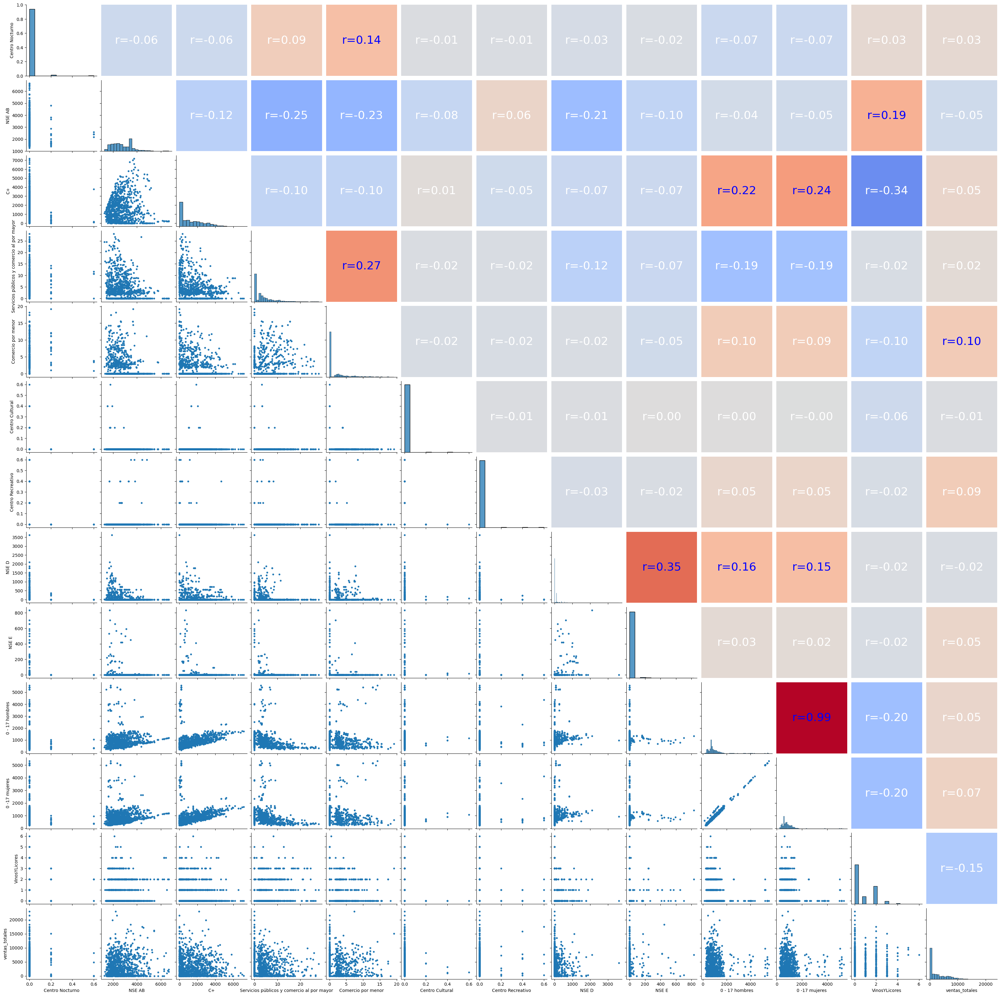

In [114]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster5) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [115]:
cantidad=cluster5.sum()
CAB=cantidad['NSE AB']
CC=cantidad['C+']
CD=cantidad['NSE D']
CE=cantidad['NSE E']
CantxVar=pd.DataFrame({'Variable':['NSE AB','C+','NSE D', 'NSE E'],
                      'cantidad':[CAB,CC,CD,CE]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,NSE AB,3702902.4
1,C+,1800320.8
2,NSE D,137885.4
3,NSE E,11961.8


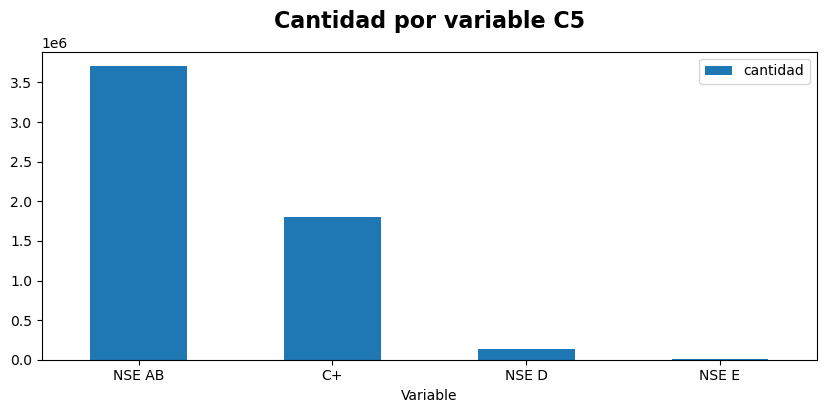

In [116]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C5',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [117]:
topNSE5=df[df.clusters==5].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE5.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE5.reset_index(inplace=True)
topNSE5=topNSE5.iloc[0:10,0:6]

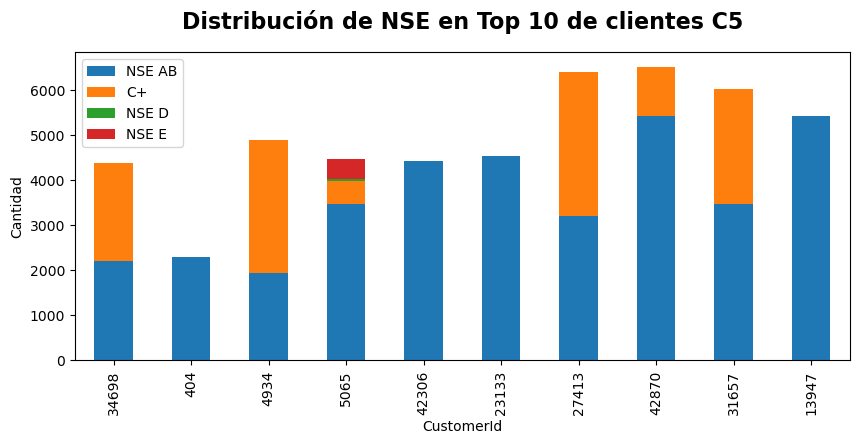

In [118]:
ax1=topNSE5.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C5',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [119]:
topCentros5=df[df.clusters==5].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros5.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros5.reset_index(inplace=True)
topCentros5=topCentros5.iloc[0:10,0:5]
topCentros5

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,34698,0.0,0.0,0.0,22937.011140
1,404,0.0,0.0,0.0,21457.661381
2,4934,0.0,0.0,0.0,19797.032989
3,5065,0.0,0.0,0.0,18315.367378
4,42306,0.0,0.0,0.6,17500.364335
5,23133,0.0,0.0,0.0,17186.279526
6,27413,0.0,0.0,0.0,16606.053032
7,42870,0.0,0.0,0.0,16208.759103
8,31657,0.0,0.0,0.0,16063.815542
9,13947,0.0,0.0,0.0,16004.209997


In [120]:
topOtros5=df[df.clusters==5].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros5.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros5.reset_index(inplace=True)
topOtros5=topOtros5.iloc[0:10,0:5]


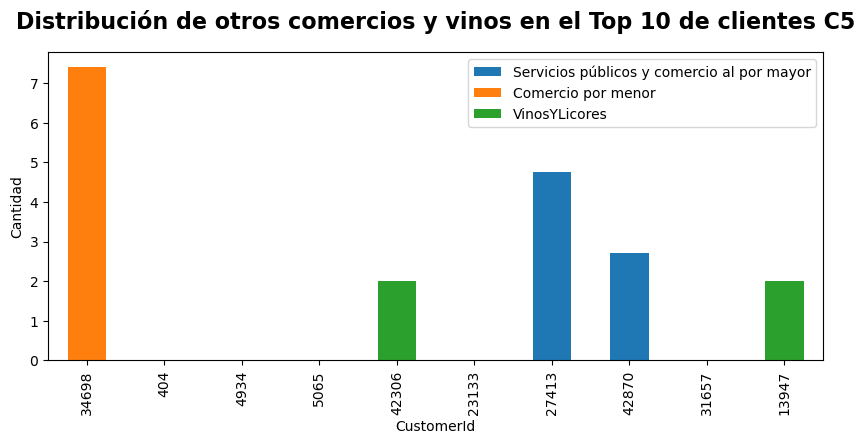

In [121]:
ax1=topOtros5.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C5',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [122]:
df45=df.sort_values('ventas_totales',ascending=False,inplace=True)
df45=df[df.clusters==5].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df45=df45.iloc[0:10,:]
df45=df45.T
df45.columns=['34698','404','4934','5065','42306','23133','27413','42870','31657','13947']

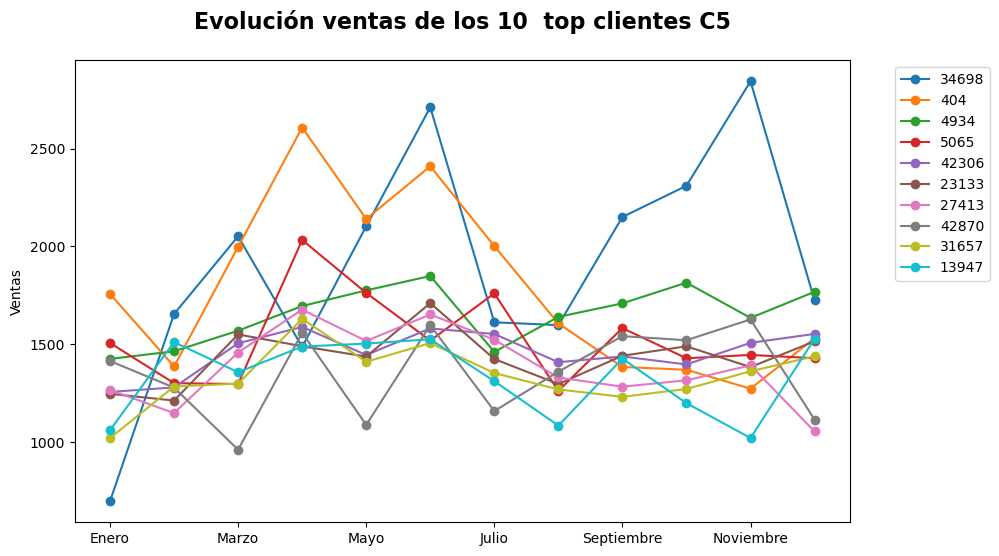

In [123]:
df45['34698'].plot(kind="line",marker="o", figsize=(10, 6),)
df45['404'].plot(kind="line",marker="o", )
df45['4934'].plot(kind="line",marker="o", )
df45['5065'].plot(kind="line",marker="o", )
df45['42306'].plot(kind="line",marker="o", )
df45['23133'].plot(kind="line",marker="o",)
df45['27413'].plot(kind="line",marker="o", )
df45['42870'].plot(kind="line",marker="o", )
df45['31657'].plot(kind="line",marker="o", )
df45['13947'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C5',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANÁLISIS CLUSTER 6

In [124]:
cluster6 = df[df.clusters==6]
cluster6=cluster6.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster6.shape

(426, 13)

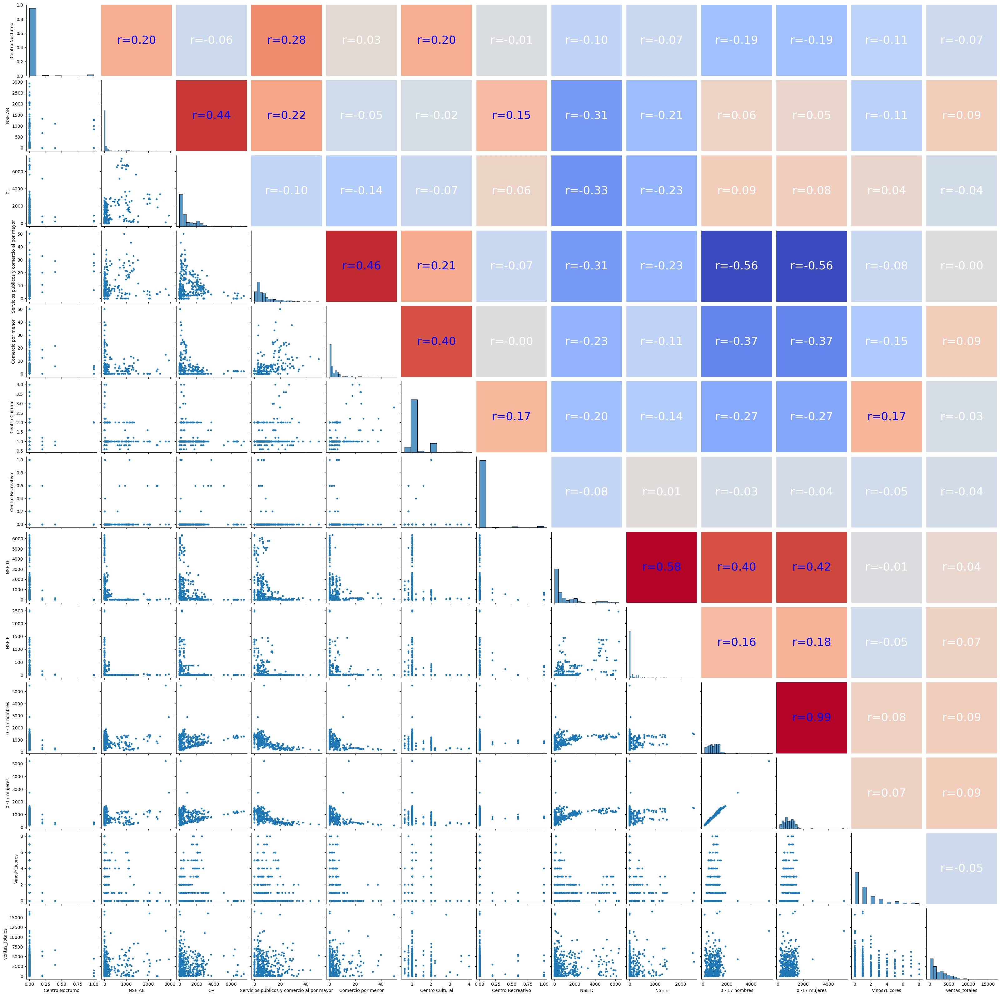

In [125]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster6) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [126]:
cantidad=cluster6.sum()
CCN=cantidad['Centro Nocturno']
CCC=cantidad['Centro Cultural']
CCR=cantidad['Centro Recreativo']
CantxVar=pd.DataFrame({'Variable':['Centro Nocturno','Centro Cultural','Centro Recreativo',],
                      'cantidad':[CCN,CCC,CCR]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,Centro Nocturno,8.6
1,Centro Cultural,501.8
2,Centro Recreativo,11.6


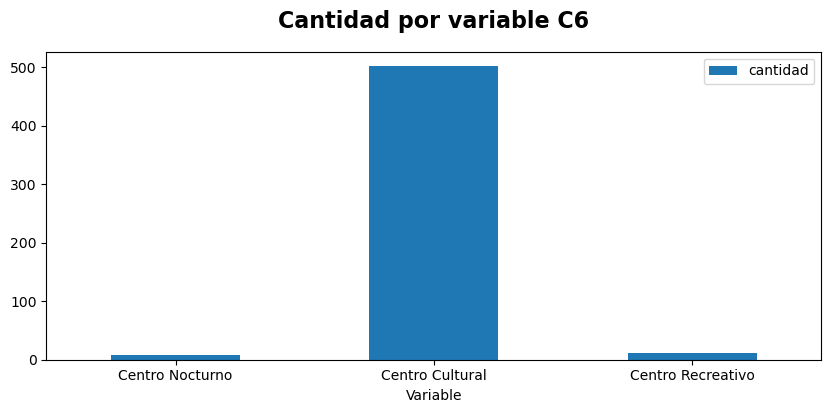

In [127]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C6',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [128]:
topNSE6=df[df.clusters==6].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE6.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE6.reset_index(inplace=True)
topNSE6=topNSE6.iloc[0:10,0:6]


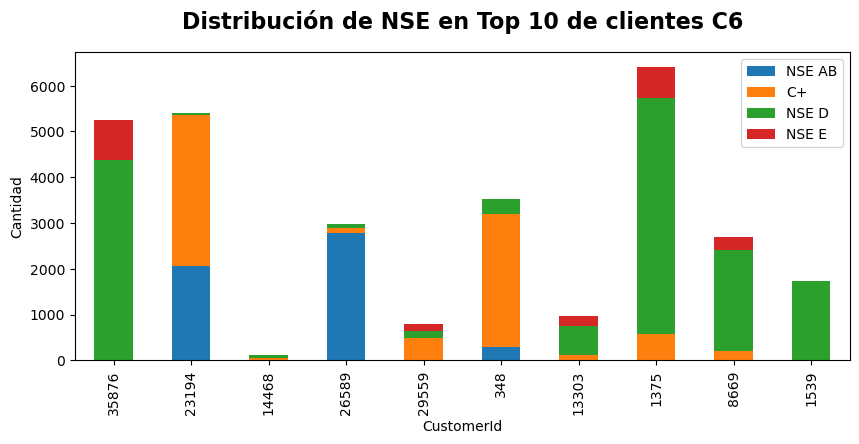

In [129]:
ax1=topNSE6.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C6',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [130]:
topCentros6=df[df.clusters==6].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros6.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros6.reset_index(inplace=True)
topCentros6=topCentros6.iloc[0:10,0:5]
topCentros6

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,35876,0.0,1.0,0.0,16569.256146
1,23194,0.0,1.0,0.0,16058.281023
2,14468,0.0,2.8,0.0,15754.562648
3,26589,0.0,1.0,0.0,11606.582627
4,29559,0.0,1.0,0.0,11345.621087
5,348,0.0,1.0,0.0,11027.912826
6,13303,0.0,1.0,0.0,10230.433064
7,1375,0.0,1.0,0.0,9395.573343
8,8669,0.0,1.0,0.0,9281.048348
9,1539,0.0,1.0,0.0,9147.760548


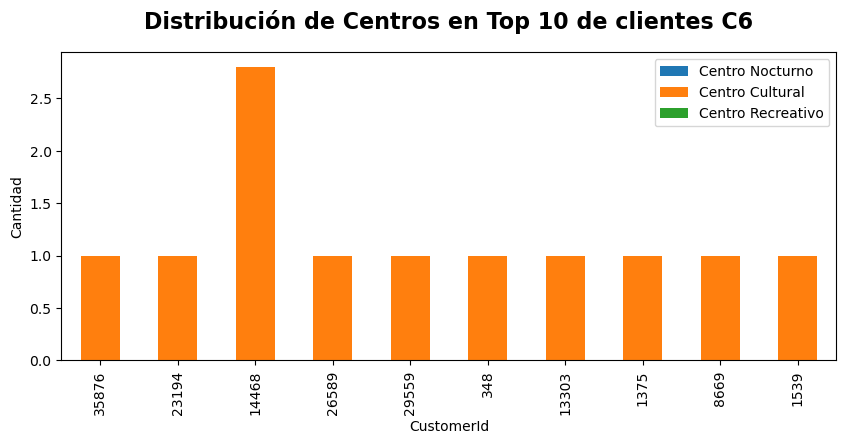

In [131]:
ax1=topCentros6.plot(x='CustomerId',
            kind='bar',
            y=['Centro Nocturno','Centro Cultural','Centro Recreativo'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de Centros en Top 10 de clientes C6',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [132]:
topOtros6=df[df.clusters==6].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros6.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros6.reset_index(inplace=True)
topOtros6=topOtros6.iloc[0:10,0:5]


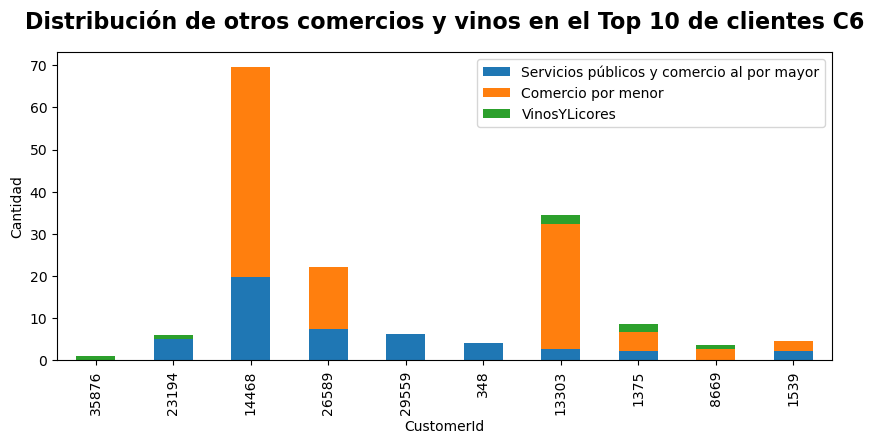

In [133]:
ax1=topOtros6.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C6',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [134]:
df46=df.sort_values('ventas_totales',ascending=False,inplace=True)
df46=df[df.clusters==6].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df46=df46.iloc[0:10,:]
df46=df46.T
df46.columns=['35876','23194','14468','26589','29559','348','13303','1375','8669','1539']

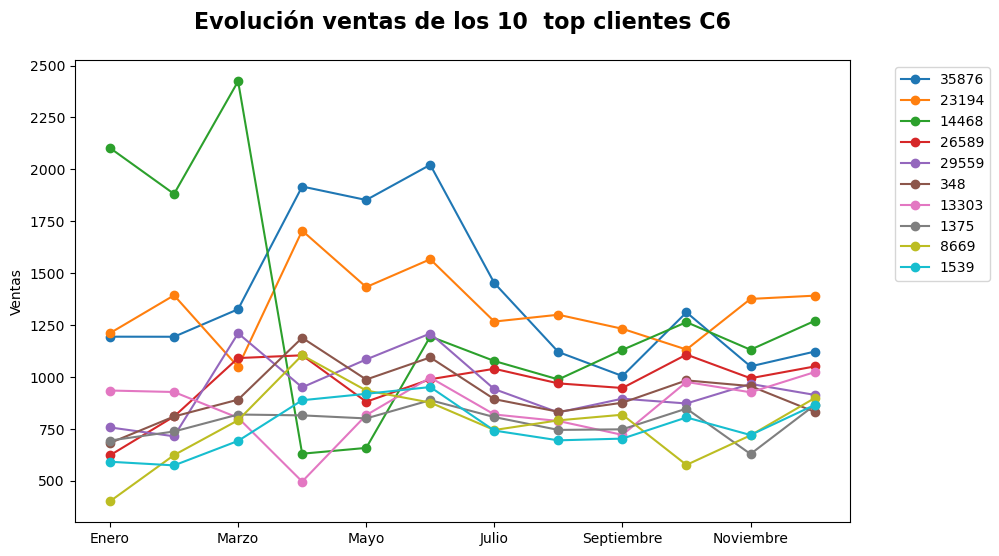

In [135]:
df46['35876'].plot(kind="line",marker="o", figsize=(10, 6),)
df46['23194'].plot(kind="line",marker="o", )
df46['14468'].plot(kind="line",marker="o", )
df46['26589'].plot(kind="line",marker="o", )
df46['29559'].plot(kind="line",marker="o", )
df46['348'].plot(kind="line",marker="o",)
df46['13303'].plot(kind="line",marker="o", )
df46['1375'].plot(kind="line",marker="o", )
df46['8669'].plot(kind="line",marker="o", )
df46['1539'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C6',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANALISIS CLUSTER 7

In [136]:
cluster7 = df[df.clusters==7]
cluster7=cluster7.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster7.shape

(3513, 13)

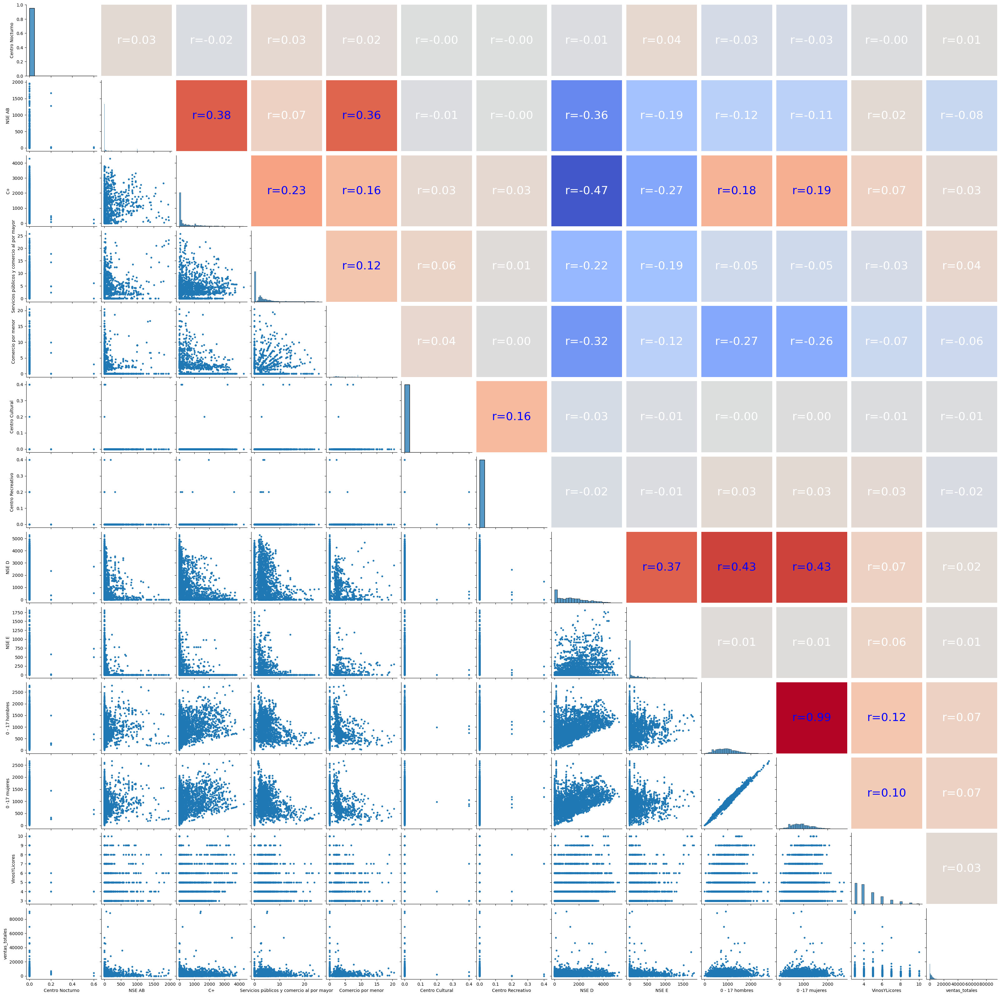

In [137]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster7) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [138]:
cantidad=cluster7.sum()
CS=cantidad['Servicios públicos y comercio al por mayor']
CCM=cantidad['Comercio por menor']
CV=cantidad['VinosYLicores']
CantxVar=pd.DataFrame({'Variable':['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
                      'cantidad':[CS,CCM,CV]})  #se suma la cantidad por var

CantxVar

,Variable,cantidad
0,Servicios públicos y comercio al por mayor,9055.443550
1,Comercio por menor,4106.515608
2,VinosYLicores,15887.000000


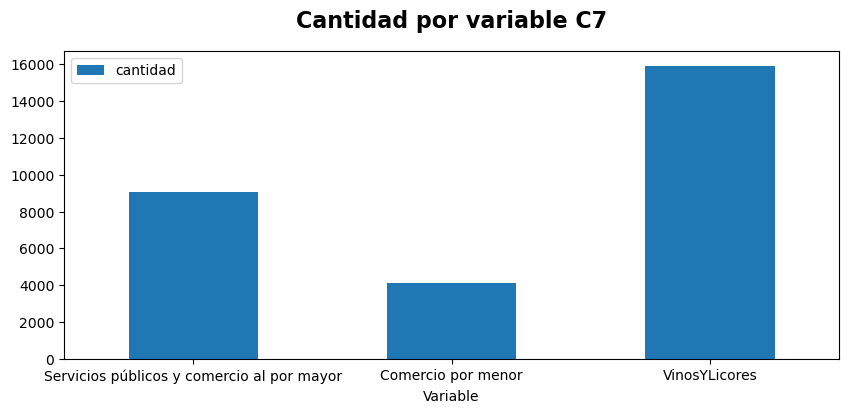

In [139]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C7',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [140]:
topNSE7=df[df.clusters==7].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE7.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE7.reset_index(inplace=True)
topNSE7=topNSE7.iloc[0:10,0:6]

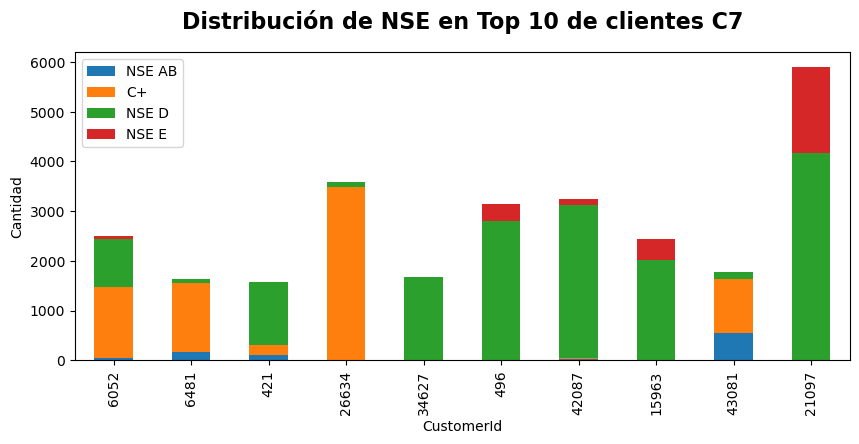

In [141]:
ax1=topNSE7.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C7',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [142]:
topCentros7=df[df.clusters==7].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros7.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros7.reset_index(inplace=True)
topCentros7=topCentros7.iloc[0:10,0:5]
topCentros7

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,6052,0.0,0.0,0.0,90805.777757
1,6481,0.0,0.0,0.0,88648.627360
2,421,0.0,0.0,0.0,69112.776538
3,26634,0.0,0.0,0.0,53894.981136
4,34627,0.0,0.0,0.0,46620.110522
5,496,0.0,0.0,0.0,45842.473798
6,42087,0.0,0.0,0.0,45481.989085
7,15963,0.0,0.0,0.0,36046.302953
8,43081,0.0,0.0,0.0,36021.674413
9,21097,0.0,0.0,0.0,33896.324144


In [143]:
topOtros7=df[df.clusters==7].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros7.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros7.reset_index(inplace=True)
topOtros7=topOtros7.iloc[0:10,0:5]


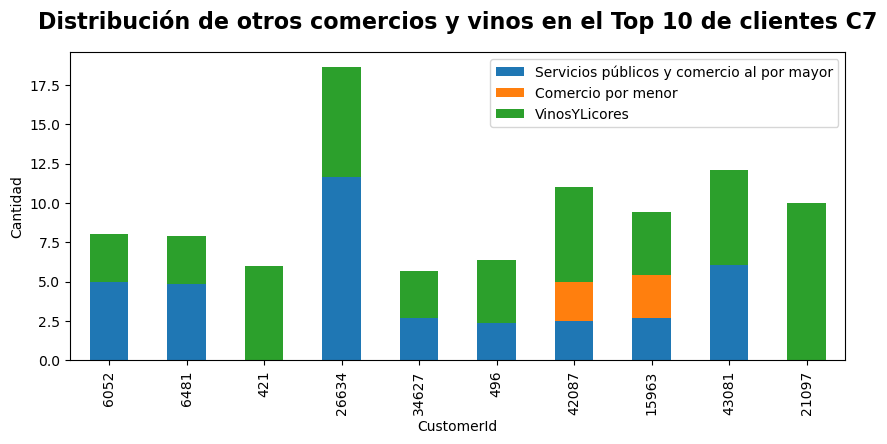

In [144]:
ax1=topOtros7.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C7',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [145]:
df47=df.sort_values('ventas_totales',ascending=False,inplace=True)
df47=df[df.clusters==7].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df47=df47.iloc[0:10,:]
df47=df47.T
df47.columns=['6052','6481','421','26634','34627','496','42087','15963','43081','21097']

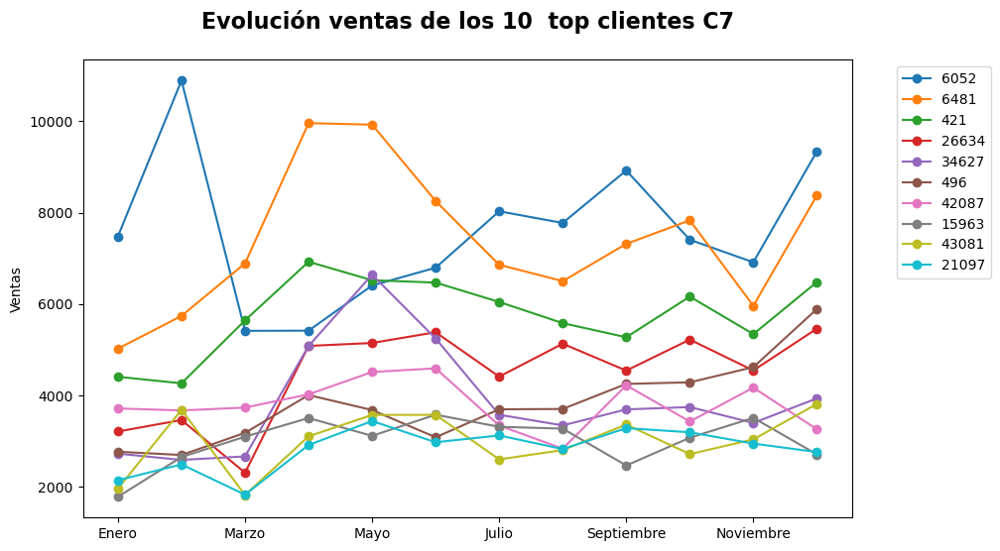

In [146]:
df47['6052'].plot(kind="line",marker="o", figsize=(10, 6),)
df47['6481'].plot(kind="line",marker="o", )
df47['421'].plot(kind="line",marker="o", )
df47['26634'].plot(kind="line",marker="o", )
df47['34627'].plot(kind="line",marker="o", )
df47['496'].plot(kind="line",marker="o",)
df47['42087'].plot(kind="line",marker="o", )
df47['15963'].plot(kind="line",marker="o", )
df47['43081'].plot(kind="line",marker="o", )
df47['21097'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C7',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANALISIS CLUSTER 8

In [147]:
cluster8 = df[df.clusters==8]
cluster8=cluster8.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster8.shape

(290, 13)

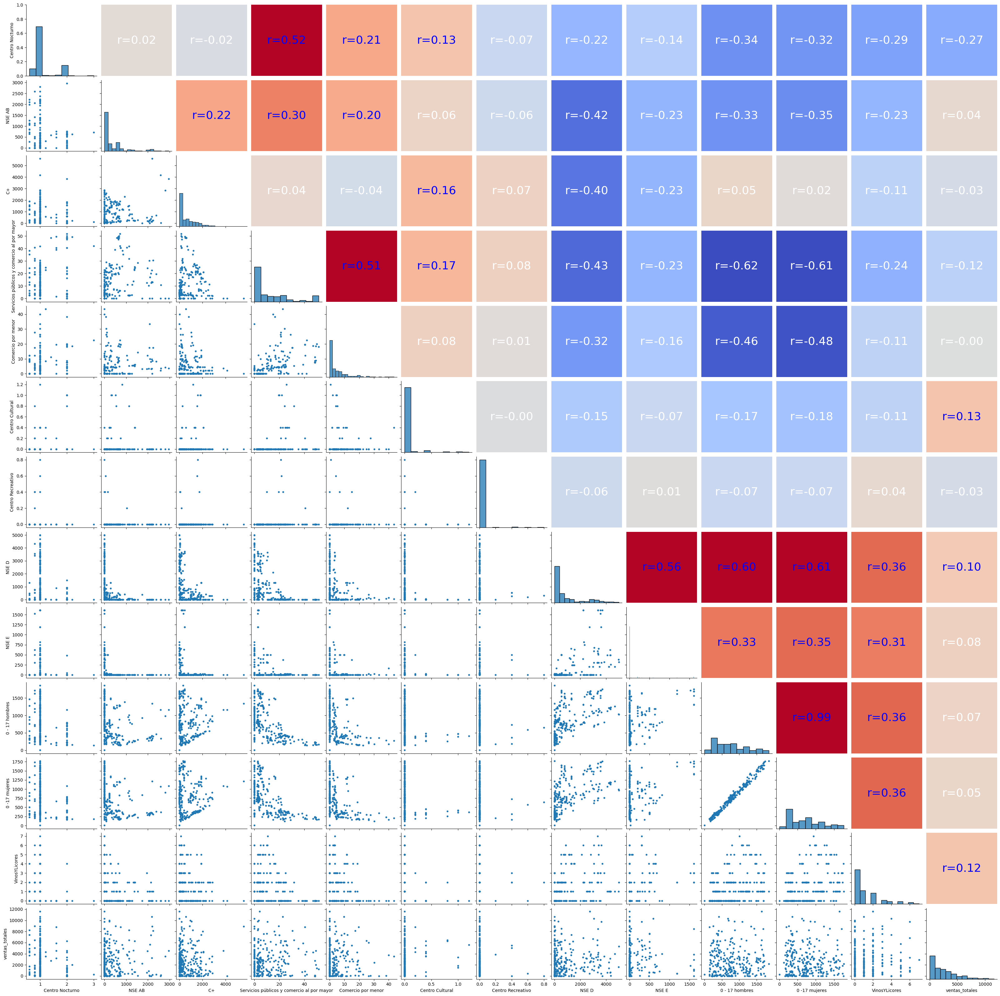

In [148]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster8) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [149]:
cantidad=cluster8.sum()
CCN=cantidad['Centro Nocturno']
CCC=cantidad['Centro Cultural']
CCR=cantidad['Centro Recreativo']
CantxVar=pd.DataFrame({'Variable':['Centro Nocturno','Centro Cultural','Centro Recreativo',],
                      'cantidad':[CCN,CCC,CCR]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,Centro Nocturno,331.8
1,Centro Cultural,9.8
2,Centro Recreativo,2.8


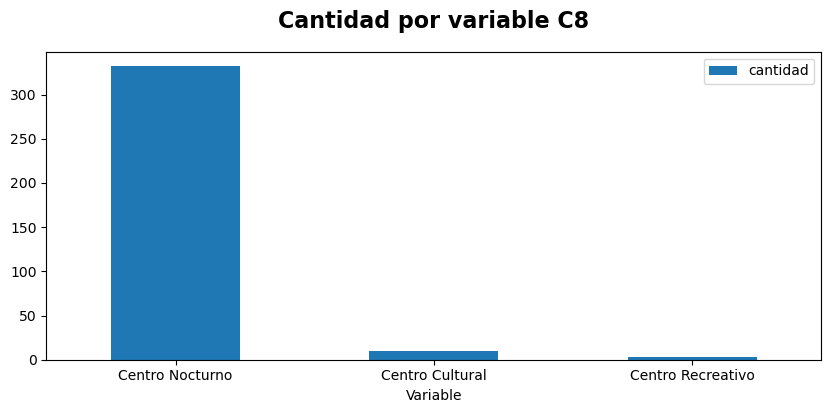

In [150]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C8',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [151]:
topNSE8=df[df.clusters==8].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE8.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE8.reset_index(inplace=True)
topNSE8=topNSE8.iloc[0:10,0:6]


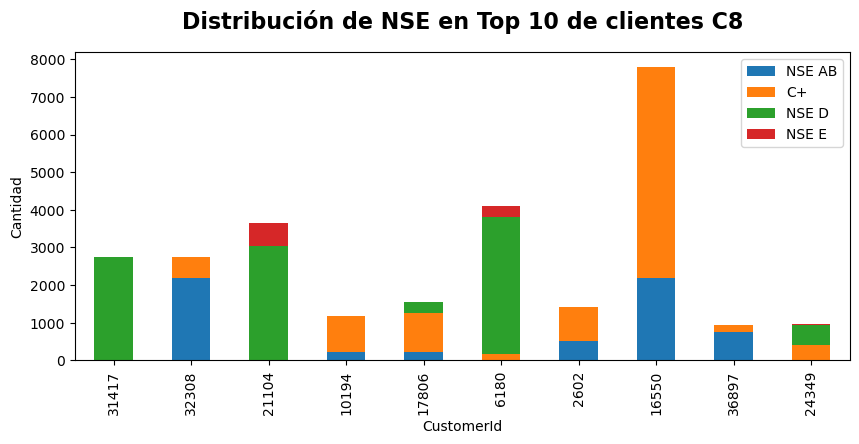

In [152]:
ax1=topNSE8.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C8',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [153]:
topCentros8=df[df.clusters==8].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros8.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros8.reset_index(inplace=True)
topCentros8=topCentros8.iloc[0:10,0:5]
topCentros8

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,31417,1.0,0.0,0.0,11599.384240
1,32308,1.0,0.0,0.0,10644.334145
2,21104,1.0,0.0,0.0,10331.545117
3,10194,1.0,0.0,0.0,9970.612339
4,17806,1.0,0.0,0.0,9828.332753
5,6180,1.0,0.0,0.0,9752.896437
6,2602,0.8,0.0,0.0,8986.032676
7,16550,1.0,0.0,0.0,8911.884044
8,36897,1.6,0.2,0.0,8812.931177
9,24349,1.0,0.0,0.0,8534.108346


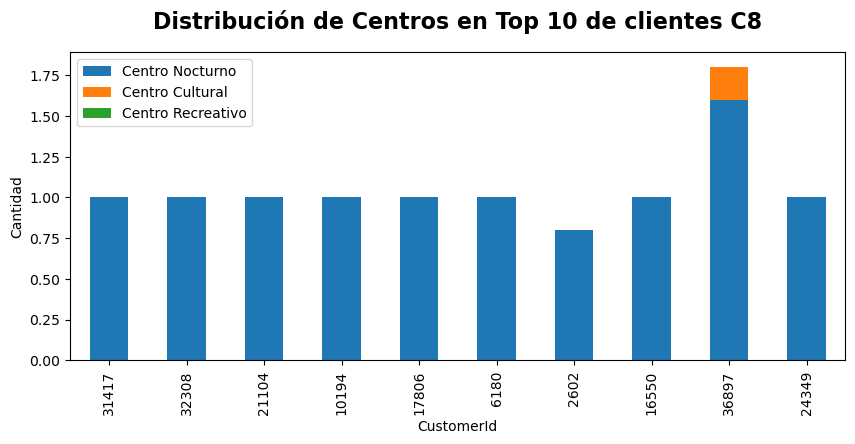

In [154]:
ax1=topCentros8.plot(x='CustomerId',
            kind='bar',
            y=['Centro Nocturno','Centro Cultural','Centro Recreativo'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de Centros en Top 10 de clientes C8',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [155]:
topOtros8=df[df.clusters==8].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros8.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros8.reset_index(inplace=True)
topOtros8=topOtros8.iloc[0:10,0:5]

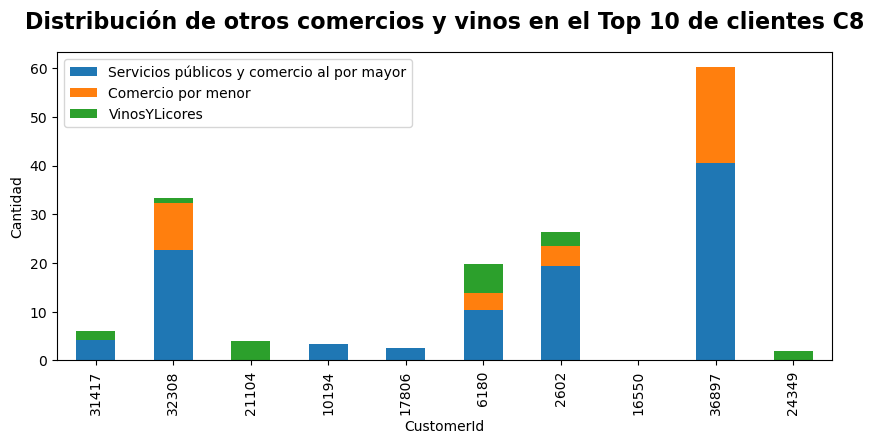

In [156]:
ax1=topOtros8.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C8',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [157]:
df48=df.sort_values('ventas_totales',ascending=False,inplace=True)
df48=df[df.clusters==8].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df48=df48.iloc[0:10,:]
df48=df48.T
df48.columns=['31417','32308','21104','10194','17806','6180','2602','16550','36897','24349']

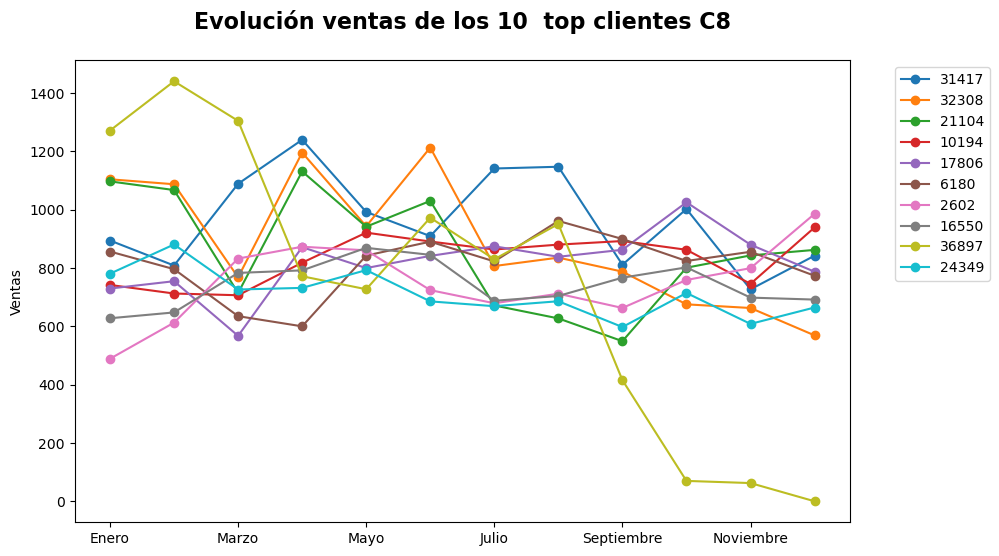

In [158]:
df48['31417'].plot(kind="line",marker="o", figsize=(10, 6),)
df48['32308'].plot(kind="line",marker="o", )
df48['21104'].plot(kind="line",marker="o", )
df48['10194'].plot(kind="line",marker="o", )
df48['17806'].plot(kind="line",marker="o", )
df48['6180'].plot(kind="line",marker="o",)
df48['2602'].plot(kind="line",marker="o", )
df48['16550'].plot(kind="line",marker="o", )
df48['36897'].plot(kind="line",marker="o", )
df48['24349'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C8',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANALISIS CLUSTER 9

In [159]:
cluster9 = df[df.clusters==9]
cluster9=cluster9.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster9.shape

(778, 13)

C:\Users\Di.LAPTOP-OGJT2TAD\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
C:\Users\Di.LAPTOP-OGJT2TAD\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
C:\Users\Di.LAPTOP-OGJT2TAD\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
C:\Users\Di.LAPTOP-OGJT2TAD\anaconda3\lib\site-packages\scipy\stats\_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
C:\Users\Di.LAPTOP-OGJT2TAD\anaconda3\lib\site-packages\scipy\stats\_stats_py.py

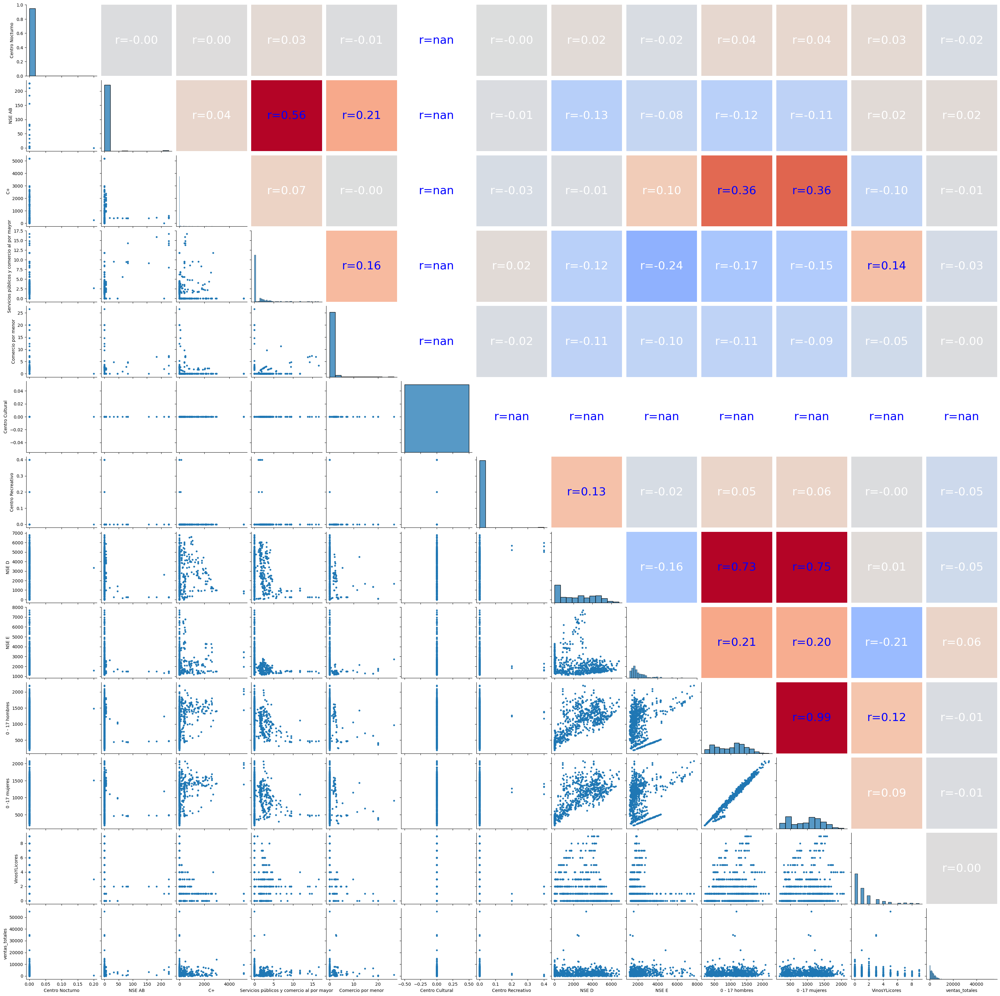

In [160]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster9) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [161]:
cantidad=cluster9.sum()
CAB=cantidad['NSE AB']
CC=cantidad['C+']
CD=cantidad['NSE D']
CE=cantidad['NSE E']
CantxVar=pd.DataFrame({'Variable':['NSE AB','C+','NSE D', 'NSE E'],
                      'cantidad':[CAB,CC,CD,CE]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,NSE AB,2310.4
1,C+,189257.2
2,NSE D,1894688.6
3,NSE E,1697008.8


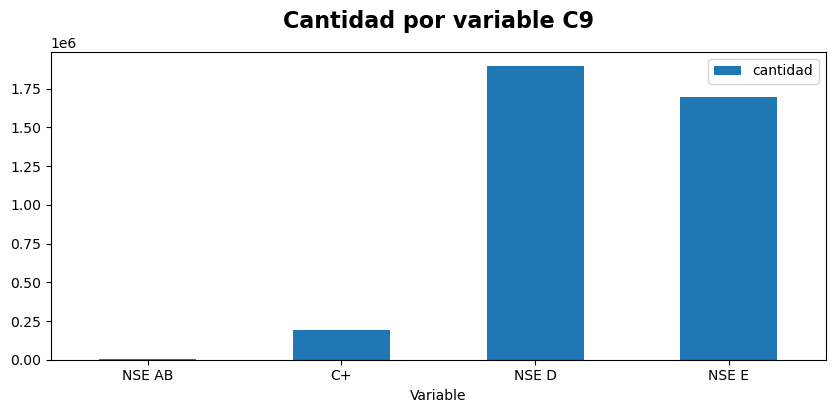

In [162]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C9',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [163]:
cantidad=cluster9.sum()
CS=cantidad['Servicios públicos y comercio al por mayor']
CCM=cantidad['Comercio por menor']
CV=cantidad['VinosYLicores']
CantxVar=pd.DataFrame({'Variable':['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
                      'cantidad':[CS,CCM,CV]})  #se suma la cantidad por var

CantxVar

,Variable,cantidad
0,Servicios públicos y comercio al por mayor,804.053366
1,Comercio por menor,315.923212
2,VinosYLicores,1088.000000


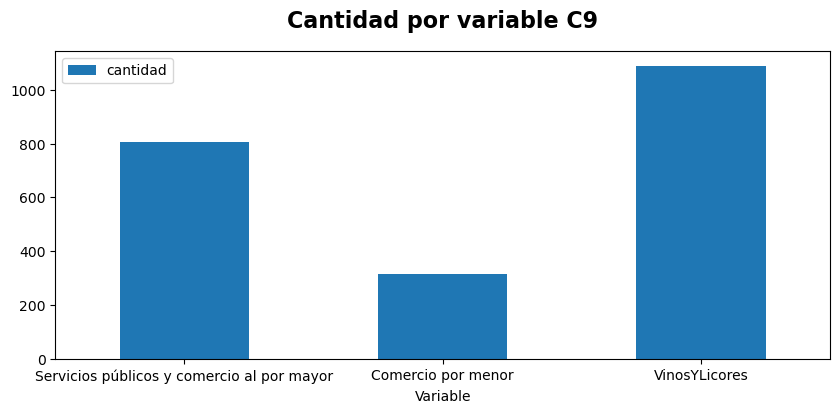

In [164]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C9',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [165]:
topNSE9=df[df.clusters==9].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE9.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE9.reset_index(inplace=True)
topNSE9=topNSE9.iloc[0:10,0:6]

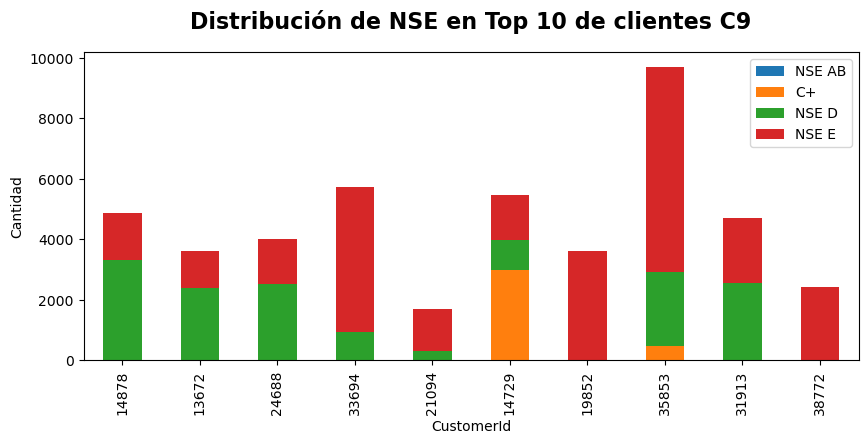

In [166]:
ax1=topNSE9.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C9',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [167]:
topCentros9=df[df.clusters==9].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros9.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros9.reset_index(inplace=True)
topCentros9=topCentros9.iloc[0:10,0:5]
topCentros9

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,14878,0.0,0.0,0.0,54908.978765
1,13672,0.0,0.0,0.0,34922.304231
2,24688,0.0,0.0,0.0,34092.629879
3,33694,0.0,0.0,0.0,21881.979115
4,21094,0.0,0.0,0.0,14832.106315
5,14729,0.0,0.0,0.0,14055.129926
6,19852,0.0,0.0,0.0,13411.860637
7,35853,0.0,0.0,0.0,12451.843926
8,31913,0.0,0.0,0.0,12301.790255
9,38772,0.0,0.0,0.0,12065.655618


In [168]:
topOtros9=df[df.clusters==9].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros9.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros9.reset_index(inplace=True)
topOtros9=topOtros9.iloc[0:10,0:5]

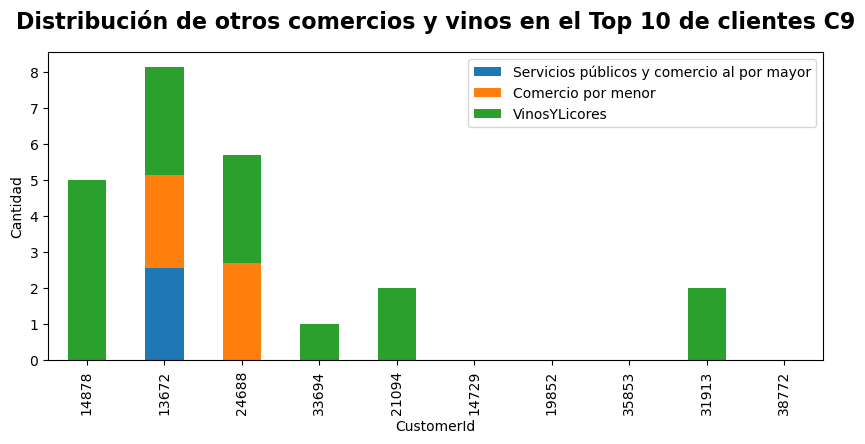

In [169]:
ax1=topOtros9.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C9',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [170]:
df49=df.sort_values('ventas_totales',ascending=False,inplace=True)
df49=df[df.clusters==9].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df49=df49.iloc[0:10,:]
df49=df49.T
df49.columns=['14878','13672','24688','33694','21094','14729','19852','35853','31913','38772']

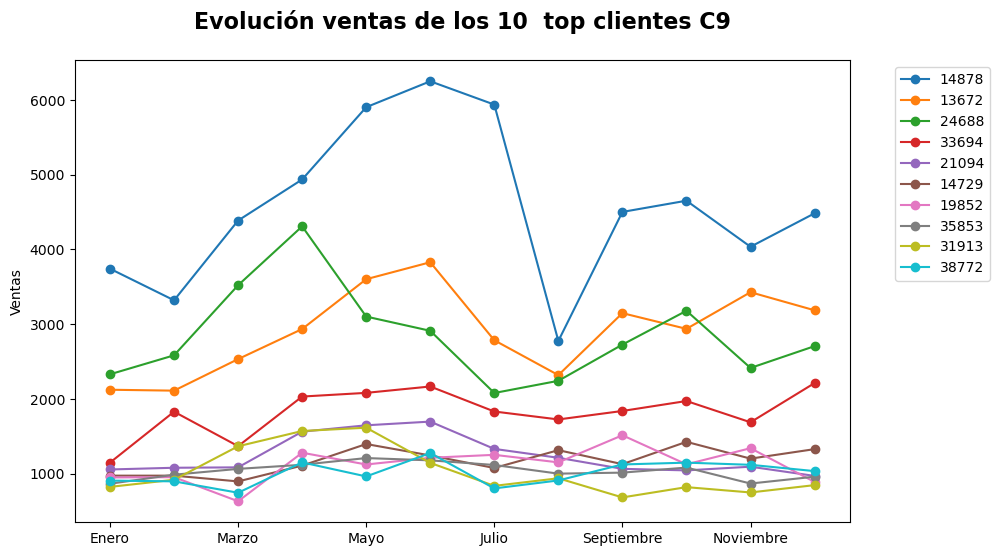

In [171]:
df49['14878'].plot(kind="line",marker="o", figsize=(10, 6),)
df49['13672'].plot(kind="line",marker="o", )
df49['24688'].plot(kind="line",marker="o", )
df49['33694'].plot(kind="line",marker="o", )
df49['21094'].plot(kind="line",marker="o", )
df49['14729'].plot(kind="line",marker="o",)
df49['19852'].plot(kind="line",marker="o", )
df49['35853'].plot(kind="line",marker="o", )
df49['31913'].plot(kind="line",marker="o", )
df49['38772'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C9',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

ANALISIS CLUSTER 10

In [172]:
cluster10 = df[df.clusters==0]
cluster10=cluster10.drop(['clusters','CustomerId','Enero', 'Febrero',
       'Marzo', 'Abril', 'Mayo', 'Junio', 'Julio', 'Agosto', 'Septiembre',
       'Octubre', 'Noviembre', 'Diciembre'],axis=1)
cluster10.shape

(2952, 13)

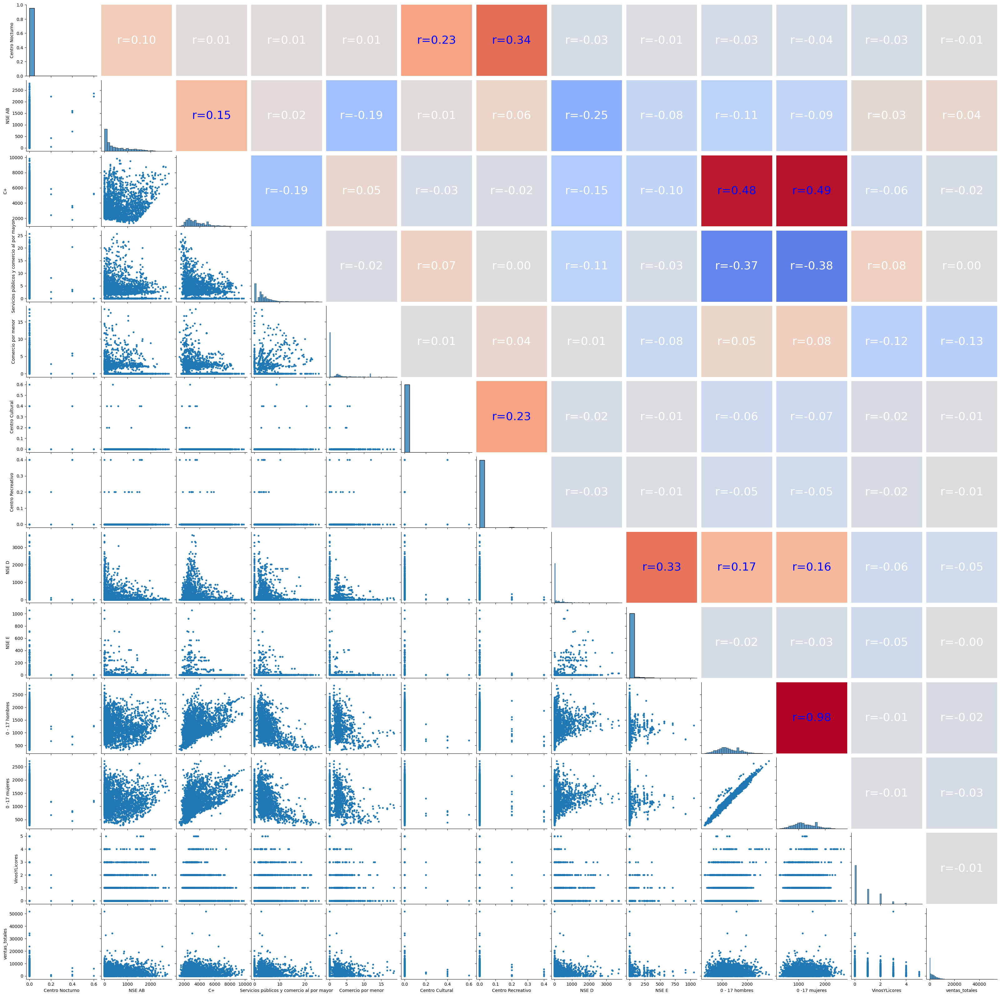

In [173]:
def corrfunc(x, y, **kwds):
    cmap = kwds['cmap']
    norm = kwds['norm']
    ax = plt.gca()
    ax.tick_params(bottom=False, top=False, left=False, right=False)
    
    sns.despine(ax=ax, bottom=True, top=True, left=True, right=True)
    r, _ = pearsonr(x, y)
    facecolor = cmap(norm(r))
    ax.set_facecolor(facecolor)
    
    lightness = (max(facecolor[:3]) + min(facecolor[:3]) ) / 2
    
    ax.annotate(f"r={r:.2f}", 
                xy=(.5, .5), 
                xycoords=ax.transAxes,
                color='white' if r < 0.1 else 'blue', #text color
                size=26, 
                ha='center', 
                va='center'
                )

g = sns.PairGrid(cluster10) #para crear la matriz de graficos 

g.map_lower(plt.scatter, 
            s=10) #grafica las dispersiones en el triangulo inferior

g.map_diag(sns.histplot, 
           kde=False) #muestra los graficos de barras en la diogonal

g.map_upper(corrfunc, 
            cmap=plt.get_cmap('coolwarm'), #https://matplotlib.org/stable/tutorials/colors/colormaps.html
            norm=plt.Normalize(vmin=-0.5, vmax=0.5)
          ) #muestra los valores de r en triangulo superior

g.fig.subplots_adjust(wspace=0.06, hspace=0.06) # equal spacing in both directions
plt.show()

In [174]:
cantidad=cluster10.sum()
CAB=cantidad['NSE AB']
CC=cantidad['C+']
CD=cantidad['NSE D']
CE=cantidad['NSE E']
CantxVar=pd.DataFrame({'Variable':['NSE AB','C+','NSE D', 'NSE E'],
                      'cantidad':[CAB,CC,CD,CE]})  #se suma la cantidad por var
CantxVar

,Variable,cantidad
0,NSE AB,1563896.0
1,C+,10927209.2
2,NSE D,696879.2
3,NSE E,40411.6


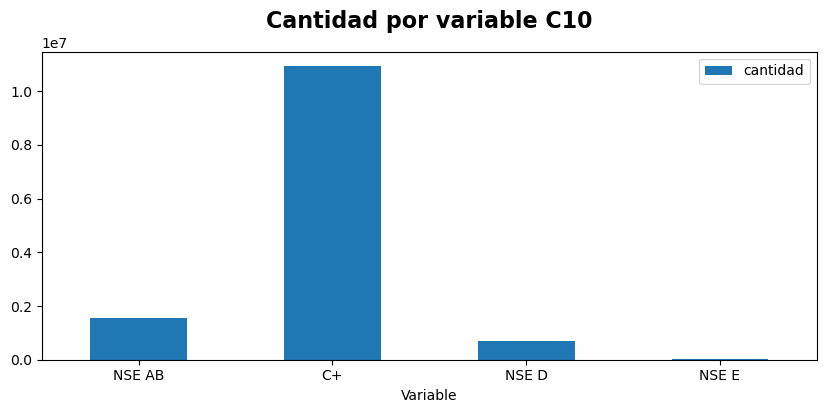

In [175]:
CantxVar.plot(x='Variable',
            kind='bar',
            y=['cantidad'],
            figsize=(10, 4))
               
plt.xticks(rotation=360)
plt.title('Cantidad por variable C10',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [176]:
topNSE10=df[df.clusters==0].pivot_table(index = ['CustomerId','NSE AB','C+','NSE D', 'NSE E'], 
               values='ventas_totales', 
                aggfunc= 'sum'
               )
topNSE10.sort_values('ventas_totales',ascending=False, inplace=True)
topNSE10.reset_index(inplace=True)
topNSE10=topNSE10.iloc[0:10,0:6]

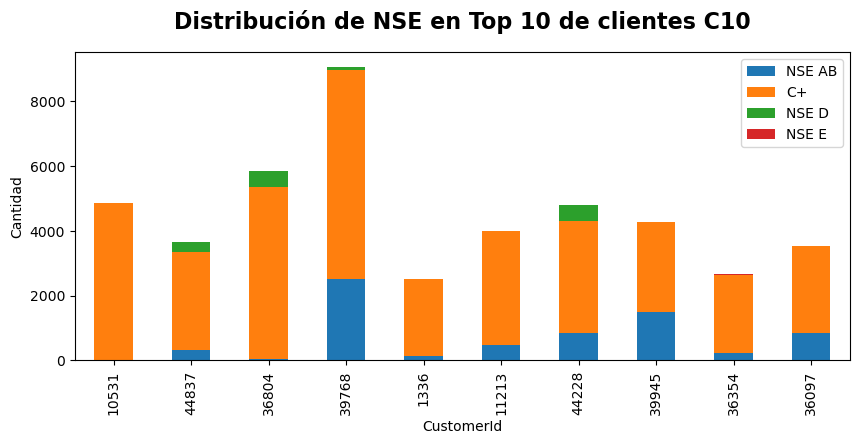

In [177]:
ax1=topNSE10.plot(x='CustomerId',
            kind='bar',
            y=['NSE AB','C+','NSE D', 'NSE E'],
            figsize=(10, 4),
            stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de NSE en Top 10 de clientes C10',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [178]:
topCentros10=df[df.clusters==0].pivot_table(index = ['CustomerId','Centro Nocturno','Centro Cultural','Centro Recreativo'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topCentros10.sort_values('ventas_totales',ascending=False, inplace=True)
topCentros10.reset_index(inplace=True)
topCentros10=topCentros10.iloc[0:10,0:5]
topCentros10

,CustomerId,Centro Nocturno,Centro Cultural,Centro Recreativo,ventas_totales
0,10531,0.0,0.0,0.0,51783.069519
1,44837,0.0,0.0,0.0,34259.025280
2,36804,0.0,0.0,0.0,32737.772081
3,39768,0.0,0.0,0.0,23664.094848
4,1336,0.0,0.0,0.0,20495.648116
5,11213,0.0,0.0,0.0,20361.536483
6,44228,0.0,0.0,0.0,19737.141341
7,39945,0.0,0.0,0.0,19120.356287
8,36354,0.0,0.0,0.0,18433.018881
9,36097,0.0,0.0,0.0,18208.193510


In [179]:
topOtros10=df[df.clusters==0].pivot_table(index = ['CustomerId','Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'], 
               values='ventas_totales', 
               aggfunc= 'sum'
               )
topOtros10.sort_values('ventas_totales',ascending=False, inplace=True)
topOtros10.reset_index(inplace=True)
topOtros10=topOtros10.iloc[0:10,0:5]

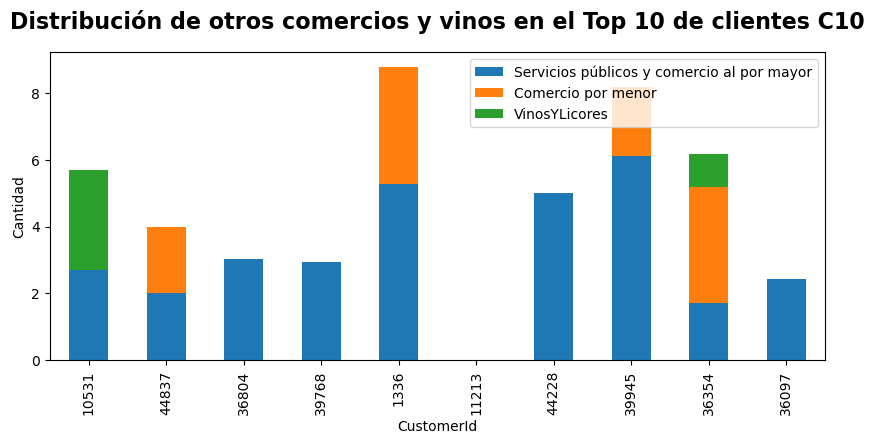

In [180]:
ax1=topOtros10.plot(x='CustomerId',
            kind='bar',
            y=['Servicios públicos y comercio al por mayor','Comercio por menor','VinosYLicores'],
           figsize=(10, 4),stacked=True
            )
ax1.set_ylabel("Cantidad")
ax1.set_title('Distribución de otros comercios y vinos en el Top 10 de clientes C10',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

In [181]:
df410=df.sort_values('ventas_totales',ascending=False,inplace=True)
df410=df[df.clusters==0].drop(['Centro Nocturno', 'NSE AB', 'C+',
       'Servicios públicos y comercio al por mayor', 'Comercio por menor',
       'Centro Cultural', 'Centro Recreativo', 'NSE D', 'NSE E',
       '0 - 17 hombres', '0 -17 mujeres', 'VinosYLicores','ventas_totales','CustomerId','clusters'],axis=1)

df410=df410.iloc[0:10,:]
df410=df410.T
df410.columns=['10531','44837','36804','39768','1336','11213','44228','39945','36354','36097']

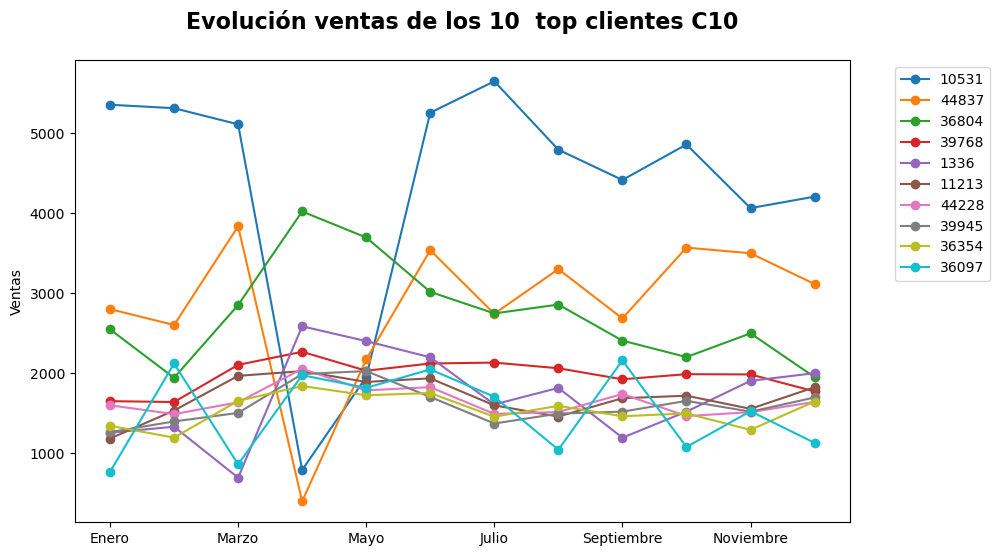

In [182]:
df410['10531'].plot(kind="line",marker="o", figsize=(10, 6),)
df410['44837'].plot(kind="line",marker="o", )
df410['36804'].plot(kind="line",marker="o", )
df410['39768'].plot(kind="line",marker="o", )
df410['1336'].plot(kind="line",marker="o", )
df410['11213'].plot(kind="line",marker="o",)
df410['44228'].plot(kind="line",marker="o", )
df410['39945'].plot(kind="line",marker="o", )
df410['36354'].plot(kind="line",marker="o", )
df410['36097'].plot(kind="line",marker="o", )

plt.legend(bbox_to_anchor=(1.05, 1.0), loc='upper left')
plt.ylabel("Ventas")
plt.title('Evolución ventas de los 10  top clientes C10',
               fontsize=16, weight="bold", y=1.05
             )
plt.show()

# REGRESION

In [183]:
import statsmodels.api as sm
from sklearn import linear_model
from scipy.stats import skew
from scipy.stats import kurtosis

In [184]:
df10=df3.copy()
df10.head()
#se copia la tabla 3 que ya incluia solo las variables necesarias

,Centro Nocturno,NSE AB,C+,Servicios públicos y comercio al por mayor,Comercio por menor,Centro Cultural,Centro Recreativo,NSE D,NSE E,0 - 17 hombres,0 -17 mujeres,VinosYLicores,ventas_totales
0,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,603.0,1321.840451,1282.971398,1.0,802.135294
1,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,0.0,1860.592252,1778.887042,0.0,883.352294
2,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,0.0,1378.389948,1292.378710,1.0,445.809998
3,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,0.0,1390.713621,1407.834826,1.0,1104.267092
4,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,0.0,1086.902775,943.756174,0.0,579.884397


In [185]:
df10=df10.rename (columns={'Centro Nocturno':'CNoc','NSE AB':'AB','C+':'C','Servicios públicos y comercio al por mayor':'Serv',
                          'Comercio por menor':'CMenor','Centro Cultural':'CCult','Centro Recreativo':'CRec',
                          'NSE D':'D','NSE E':'E','0 - 17 hombres':'H','0 -17 mujeres':'M','VinosYLicores':'Vinos'})
df10.head()
#se cambian nombnres a columnas ya que el algoritmo no corria con los nombres largos y separados

,CNoc,AB,C,Serv,CMenor,CCult,CRec,D,E,H,M,Vinos,ventas_totales
0,0.0,0.0,840.0,1.886792,3.773585,0.0,0.0,2425.0,603.0,1321.840451,1282.971398,1.0,802.135294
1,0.0,0.0,2552.0,2.439024,2.439024,0.0,0.0,1229.0,0.0,1860.592252,1778.887042,0.0,883.352294
2,0.0,0.0,1430.0,0.000000,0.000000,0.0,0.0,1055.0,0.0,1378.389948,1292.378710,1.0,445.809998
3,0.0,0.0,2145.0,0.000000,0.000000,0.0,0.0,1549.0,0.0,1390.713621,1407.834826,1.0,1104.267092
4,0.0,0.0,437.0,2.777778,0.000000,0.0,0.0,740.0,0.0,1086.902775,943.756174,0.0,579.884397


In [186]:
df10[df10==0].count()
#se hace un conteo de cuantos valores 0 hay en cada columna, no deben haber 0 en var dependiente

CNoc              28016
AB                19013
C                 10466
Serv              12366
CMenor            21543
CCult             27895
CRec              28000
D                  4760
E                 15794
H                     0
M                     0
Vinos             13636
ventas_totales        0
dtype: int64

In [187]:
modelA=sm.OLS.from_formula('ventas_totales~ CNoc+ AB + C + Serv + CMenor + CCult + CRec + D + E + H + M + Vinos',
                          data=df10)
resultA=modelA.fit()
resultA.summary()
#se ejecuta un primer modelo con todas las var segun PCA

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         ventas_totales   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     6.205
Date:                Thu, 30 Mar 2023   Prob (F-statistic):           4.82e-11
Time:                        11:24:17   Log-Likelihood:            -2.7274e+05
No. Observations:               28460   AIC:                         5.455e+05
Df Residuals:                   28447   BIC:                         5.456e+05
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   2560.1255     54.555     46.928      0.000    2453.196    2667.055
CNoc        -532.2871    168.352     -3.162      0.002    -862.266    -202.308
AB             0.0041      0.033      0.127      0.899      -0.060       0.068
C             -0.0174      0.020     -0.862      0.389      -0.057       0.022
Serv          27.6617      4.339      6.376      0.000      19.158      36.166
CMenor       -14.3923      4.588     -3.137      0.002     -23.385      -5.400
CCult       -216.6526    133.603     -1.622      0.105    -478.521      45.216
CRec         445.1503    177.305      2.511      0.012      97.624     792.676
D             -0.0414      0.016     -2.537      0.011      -0.073      -0.009
E              0.0858      0.048      1.775      0.076      -0.009       0.181
H              0.0015      0.371      0.004      0.997      -0.725       0.728
M              0.2358      0.383      0.616      0.538      -0.514       0.986
Vinos         -4.7963     12.701     -0.378      0.706     -29.690      20.098
==============================================================================
Omnibus:                    39715.995   Durbin-Watson:                   1.767
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         25459291.053
Skew:                           7.884   Prob(JB):                         0.00
Kurtosis:                     148.674   Cond. No.                     2.24e+04
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.24e+04. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [188]:
df10norm = df10.apply(preprocessing.scale, axis=0)
df10norm.head()
#se estandarizan los datos

,CNoc,AB,C,Serv,CMenor,CCult,CRec,D,E,H,M,Vinos,ventas_totales
0,-0.11016,-0.37211,0.043256,-0.219239,0.467885,-0.123749,-0.119166,0.530542,0.880218,0.757437,0.745677,-0.115132,-0.560699
1,-0.11016,-0.37211,1.358943,-0.115541,0.191981,-0.123749,-0.119166,-0.169057,-0.435508,1.873800,1.797975,-0.720797,-0.537609
2,-0.11016,-0.37211,0.496676,-0.573541,-0.312256,-0.123749,-0.119166,-0.270838,-0.435508,0.874615,0.765639,-0.115132,-0.662001
3,-0.11016,-0.37211,1.046160,-0.573541,-0.312256,-0.123749,-0.119166,0.018127,-0.435508,0.900151,1.010629,-0.115132,-0.474804
4,-0.11016,-0.37211,-0.266453,-0.051930,-0.312256,-0.123749,-0.119166,-0.455097,-0.435508,0.270616,0.025887,-0.720797,-0.623884


In [189]:
modelA=sm.OLS.from_formula('ventas_totales~ CNoc + AB + C + Serv + CMenor + CCult + CRec + D + E + H + M + Vinos',
                          data=df10norm)
resultA=modelA.fit()
resultA.summary() 
#modelo con datos estandarizados

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         ventas_totales   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     6.205
Date:                Thu, 30 Mar 2023   Prob (F-statistic):           4.82e-11
Time:                        11:24:17   Log-Likelihood:                -40346.
No. Observations:               28460   AIC:                         8.072e+04
Df Residuals:                   28447   BIC:                         8.082e+04
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1.475e-17      0.006   2.49e-15      1.000      -0.012       0.012
CNoc          -0.0194      0.006     -3.162      0.002      -0.031      -0.007
AB             0.0008      0.006      0.127      0.899      -0.012       0.013
C             -0.0064      0.007     -0.862      0.389      -0.021       0.008
Serv           0.0419      0.007      6.376      0.000       0.029       0.055
CMenor        -0.0198      0.006     -3.137      0.002      -0.032      -0.007
CCult         -0.0097      0.006     -1.622      0.105      -0.021       0.002
CRec           0.0149      0.006      2.511      0.012       0.003       0.027
D             -0.0201      0.008     -2.537      0.011      -0.036      -0.005
E              0.0112      0.006      1.775      0.076      -0.001       0.024
H              0.0002      0.051      0.004      0.997      -0.100       0.100
M              0.0316      0.051      0.616      0.538      -0.069       0.132
Vinos         -0.0023      0.006     -0.378      0.706      -0.014       0.009
==============================================================================
Omnibus:                    39715.995   Durbin-Watson:                   1.767
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         25459291.053
Skew:                           7.884   Prob(JB):                         0.00
Kurtosis:                     148.674   Cond. No.                         19.2
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [190]:
resultA.fittedvalues
#valores estimados

0        0.005658
1        0.041209
2        0.005429
3        0.003820
4        0.013767
           ...   
46646   -0.164559
46647   -0.053950
46648   -0.057795
46653   -0.015677
46654   -0.020998
Length: 28460, dtype: float64

In [191]:
resultA.resid
#residuos/errores

0       -0.566357
1       -0.578819
2       -0.667430
3       -0.478625
4       -0.637651
           ...   
46646   -0.573215
46647   -0.734515
46648   -0.730521
46653   -0.756728
46654   -0.762898
Length: 28460, dtype: float64

In [192]:
modelA=sm.OLS.from_formula('ventas_totales~ CNoc+Serv+CMenor+CRec+D',
                          data=df10norm)
resultA=modelA.fit()
resultA.summary() 
#modelo con datos estandarizados, pero salen:ab,c,ccult,e,h,m,vinos, por p values menores al 0.05 y coef bajos igual


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         ventas_totales   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                  0.002
Method:                 Least Squares   F-statistic:                     9.896
Date:                Thu, 30 Mar 2023   Prob (F-statistic):           1.80e-09
Time:                        11:24:18   Log-Likelihood:                -40358.
No. Observations:               28460   AIC:                         8.073e+04
Df Residuals:                   28454   BIC:                         8.078e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1.475e-17      0.006   2.49e-15      1.000      -0.012       0.012
CNoc          -0.0198      0.006     -3.228      0.001      -0.032      -0.008
Serv           0.0368      0.006      5.689      0.000       0.024       0.049
CMenor        -0.0221      0.006     -3.514      0.000      -0.034      -0.010
CRec           0.0155      0.006      2.614      0.009       0.004       0.027
D             -0.0034      0.006     -0.568      0.570      -0.015       0.008
==============================================================================
Omnibus:                    39695.337   Durbin-Watson:                   1.766
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         25365050.044
Skew:                           7.877   Prob(JB):                         0.00
Kurtosis:                     148.403   Cond. No.                         1.56
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [193]:
df10['ventas_totales'].describe()
#estadisticas descriptivas de la var dependiente

count     28460.000000
mean       2774.377023
std        3517.531207
min           0.035225
25%         542.135623
50%        2019.765938
75%        3966.037276
max      114353.828983
Name: ventas_totales, dtype: float64

In [194]:
print('skewness is:',skew(df10['ventas_totales']
          ))
print('kurtosis is:',kurtosis(df10['ventas_totales']
              ))
#viendo las estadisticas descriptivas de ventas, la media no es igual a mediana,
#tiene una kurtosis mayor a 3 y un skewness mayor a 0. 

skewness is: 7.881616927356874
kurtosis is: 145.3307663165877


In [195]:
px.histogram(df10, 
                   x='ventas_totales',
            )
#en el grafico se comprueba que su distribucion es muy asimetrica 

In [196]:
vlog=np.log(df10['ventas_totales'])
#se saca el logaritmo natural de la variable dependiente, ya que cuando tiene un comportamiento tan asimetrico, mucha parte
# de la data suele quedar sin explicacion

In [197]:
df10.insert(0,'vlog',vlog)
#se inserta esta nueva variable a la tabla

In [198]:
df10norm = df10.apply(preprocessing.scale, axis=0)
df10norm.head()
#se vuelve a estandarizar df10 con la nueva variable vlog

,vlog,CNoc,AB,C,Serv,CMenor,CCult,CRec,D,E,H,M,Vinos,ventas_totales
0,-0.098563,-0.11016,-0.37211,0.043256,-0.219239,0.467885,-0.123749,-0.119166,0.530542,0.880218,0.757437,0.745677,-0.115132,-0.560699
1,-0.052737,-0.11016,-0.37211,1.358943,-0.115541,0.191981,-0.123749,-0.119166,-0.169057,-0.435508,1.873800,1.797975,-0.720797,-0.537609
2,-0.377653,-0.11016,-0.37211,0.496676,-0.573541,-0.312256,-0.123749,-0.119166,-0.270838,-0.435508,0.874615,0.765639,-0.115132,-0.662001
3,0.053321,-0.11016,-0.37211,1.046160,-0.573541,-0.312256,-0.123749,-0.119166,0.018127,-0.435508,0.900151,1.010629,-0.115132,-0.474804
4,-0.252722,-0.11016,-0.37211,-0.266453,-0.051930,-0.312256,-0.123749,-0.119166,-0.455097,-0.435508,0.270616,0.025887,-0.720797,-0.623884


In [199]:
print('skewness is:',skew(df10norm['vlog']
          ))
print('kurtosis is:',kurtosis(df10norm['vlog']
              ))
#da lo mismo usar df10norm y df10 por que con la estandarizacion solo cambia escala a una mas pequeña
#se va a distribuir de la misma forma la variable estandarizada que la sin estandarizar

skewness is: -1.4790555158299994
kurtosis is: 1.587970781503257


In [200]:
df10norm['vlog'].describe()

count    2.846000e+04
mean    -2.289884e-17
std      1.000018e+00
min     -4.865784e+00
25%     -2.847047e-01
50%      3.402107e-01
75%      6.608291e-01
max      2.258030e+00
Name: vlog, dtype: float64

In [201]:
px.histogram(df10norm, 
                   x='vlog',
            )
#se grafica la variable vlog y su distribucion cambia

In [202]:
modelA=sm.OLS.from_formula('vlog~ CNoc + Serv + CMenor + CRec + E + M',
                          data=df10norm)
resultA=modelA.fit()
resultA.summary()
#se introduce la nueva variable vlog como variable dependiente/explicada, para ver si R^2 mejora
#se quita ccult y d por p values
#se quitan todos los niveles socioeconomicos a excepcion de E (que es el segundo nivel socioeconomico con mas gente) 
#por que los niveles socioeconomicos estan más correlacionados entre si
#se quita el genero hombre por la alta correlacion con mujer, es decir, basta con poner solo 1 genero si se comportan igual
#tb se quita vinos por p value

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                   vlog   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.010
Method:                 Least Squares   F-statistic:                     48.07
Date:                Thu, 30 Mar 2023   Prob (F-statistic):           5.05e-59
Time:                        11:24:19   Log-Likelihood:                -40239.
No. Observations:               28460   AIC:                         8.049e+04
Df Residuals:                   28453   BIC:                         8.055e+04
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   5.074e-17      0.006    8.6e-15      1.000      -0.012       0.012
CNoc          -0.0210      0.006     -3.444      0.001      -0.033      -0.009
Serv           0.0265      0.006      4.093      0.000       0.014       0.039
CMenor        -0.0730      0.006    -11.682      0.000      -0.085      -0.061
CRec           0.0128      0.006      2.176      0.030       0.001       0.024
E              0.0529      0.006      8.882      0.000       0.041       0.065
M              0.0303      0.006      5.020      0.000       0.018       0.042
==============================================================================
Omnibus:                     6609.307   Durbin-Watson:                   1.097
Prob(Omnibus):                  0.000   Jarque-Bera (JB):            12707.775
Skew:                          -1.443   Prob(JB):                         0.00
Kurtosis:                       4.546   Cond. No.                         1.59
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [212]:
f=resultA.fittedvalues

In [206]:
resultA.resid.describe()

count    2.846000e+04
mean     6.701908e-18
std      9.949876e-01
min     -4.858540e+00
25%     -2.941490e-01
50%      3.230871e-01
75%      6.594716e-01
max      2.272305e+00
dtype: float64

In [204]:
np.exp(resultA.fittedvalues)

0        1.030430
1        1.015225
2        1.008531
3        1.016042
4        0.999933
           ...   
46646    0.830502
46647    0.948453
46648    0.877149
46653    0.977360
46654    1.026154
Length: 28460, dtype: float64

In [207]:
import plotly.express as px 

In [214]:
px.scatter(x=f)